In [2]:
#General Procedure:

#The main problem we are trying to solve is to see under what conditions the continuum gradient can give us 
#a measurement of the local pressure gradient to better understand the formation of disk sub-structure. To compute
#the pressure gradient, we need the gas surface density and temperature gradients. To compute the continuum 
#gradient, we need the gradients of the temperature, gas surface density, dust-gas ratio, and opacity. If the
#dust-gas ratio and opacity gradients are negligible, then there will be a direct correspondance between the
#continuum and pressure gradients. To find the limitations of the correspondance, we want to analyze
#how the dust-gas ratio and opacity gradients behave as the model changes. Two ways to change the model to identify
#and describe trends in dust-gas ratio and opacity gradients are through changes in the dust population and changes
#in the location and amplitude of the surface density perturbation. We also want to see how much noise can be
#present before the correspondance breaks. 

#Next Goals: 

#Look into built in python maxima functions
#Stats and signal processing library
#Look into interpolation and prob distributions (interpolate grid)
#Looking forward: perturbation parameter search for difference dust populations / opacities
#We want to be able to find the opacity as a function of radius for a given perturbation
#and then find the maximum opacity as a function of perturbation amplitude and location
#Create surface density distributions for every dust population based on their mass contribution and repeat 
#the temperature variation fitting process
#dust scale height is .2 or .3 of the gas height
#Pkl tool = fast way of saving everything in dictionary to a file
#Pickle module can read them
#Before 11 or after 4
#Install optool and learn the ropes
#Larger dust particles will concentrate around the perturbations

#Questions:
#Is the radial variation of the opacity only dependent on the radial variation of the density of the different
#dust populations?
#I tried using dustopac.writeOpac() to create dustkappa_ext.inp files, but I kept getting blank files. What
#do I use to create more dust populations?
#Take optool, assume composition, closely match dsharp compositions, vary the prominence of each bin to see
#when a bin creates a desired change in opacity
#

#Defining necessary constants
# Import NumPy for array handling
#
import numpy as np
import matplotlib.pyplot as plt
import scipy as sp
from radmc3dPy import *
import subprocess as p

#
# A simple grid refinement function
#
def grid_refine_inner_edge(x_orig,nlev,nspan):
    x     = x_orig.copy()
    rev   = x[0]>x[1]
    for ilev in range(nlev):
        x_new = 0.5 * ( x[1:nspan+1] + x[:nspan] )
        x_ref = np.hstack((x,x_new))
        x_ref.sort()
        x     = x_ref
        if rev:
            x = x[::-1]
    return x
#
# Some natural constants
#
au  = 1.49598e13     # Astronomical Unit       [cm]
pc  = 3.08572e18     # Parsec                  [cm]
ms  = 1.98892e33     # Solar mass              [g]
ts  = 5.78e3         # Solar temperature       [K]
ls  = 3.8525e33      # Solar luminosity        [erg/s]
rs  = 6.96e10        # Solar radius            [cm]
ss  = 5.6703e-5      # Stefan-Boltzmann const  [erg/cm^2/K^4/s]
kk  = 1.3807e-16     # Bolzmann's constant     [erg/K]
mp  = 1.6726e-24     # Mass of proton          [g]
GG  = 6.67408e-08    # Gravitational constant  [cm^3/g/s^2]
pi  = np.pi          # Pi

#
# Star parameters
#
mstar    = ms
rstar    = rs
tstar    = ts
pstar    = np.array([0.,0.,0.])

#
# First make a simple analytical disk model roughly along the
# lines of Chiang & Goldreich (1997), but with just a single
# vertical layer and with a constant radiative incidence angle.
#
flang    = 0.05      # The assumed constant radiative incidence angle
nr       = 500        # Nr of radial grid points
rin      = 1*au     # Inner radius
rout     = 260*au    # Outer radius
nlev_rin = 12        # Grid refinement at the inner edge: nr of cycles
nspan_rin= 3         # Grid refinement at the inner edge: nr of cells each cycle
ri       = np.logspace(np.log10(rin),np.log10(rout),nr+1)
#ri       = grid_refine_inner_edge(ri,nlev_rin,nspan_rin)   # Refinement at inner edge
rc       = 0.5 * ( ri[:-1] + ri[1:] )
nr       = len(rc)   # Recompute nr, because of refinement at inner edge
r        = rc        # The radial grid of the analytic disk model
lstar    = 4*pi*rstar**2*ss*tstar**4   # Stellar luminosity
firr     = flang*lstar/(4*pi*r**2)     # Irradiative flux
tmid     = (firr/ss)**0.25             # Estimate of midplane temperature
cs       = np.sqrt(kk*tmid/(2.3*mp))   # Isothermal sound speed at midplane
omk      = np.sqrt(GG*mstar/r**3)      # The Kepler angular frequency     
hp       = cs/omk                      # The pressure scale height
hpr      = hp/r                        # The dimensionless hp

#
# Vertical grid parameters (theta-grid in spherical coordinates)
#
ntheta   = 100
zrmax    = 0.5
thetaup  = np.pi*0.5 - 0.5e0

#
# Make the theta and phi coordinates
#
nphi     = 10
thetai   = np.linspace(thetaup,0.5e0*np.pi,ntheta+1)
phii     = np.linspace(0.e0,np.pi*2.e0,nphi+1)
thetac   = 0.5 * ( thetai[0:ntheta] + thetai[1:ntheta+1] )
phic     = 0.5 * ( phii[0:nphi] + phii[1:nphi+1] )

#
# Make the 2-D grid (actually 3-D but with axisymmetry)
#
qq       = np.meshgrid(rc,thetac,phic,indexing='ij')
rr       = qq[0]
tt       = qq[1]
zr       = np.pi/2.e0 - qq[1]

# Monte Carlo parameters
#
nphot    = 1000000

#
# Write the wavelength_micron.inp file
#
lam1     = 0.1e0
lam2     = 7.0e0
lam3     = 25.e0
lam4     = 1.0e4
n12      = 20
n23      = 100
n34      = 30
lam12    = np.logspace(np.log10(lam1),np.log10(lam2),n12,endpoint=False)
lam23    = np.logspace(np.log10(lam2),np.log10(lam3),n23,endpoint=False)
lam34    = np.logspace(np.log10(lam3),np.log10(lam4),n34,endpoint=True)
lam      = np.concatenate([lam12,lam23,lam34])
nlam     = lam.size
    


In [1]:
print(nr)
print(hp / np.gradient(r))
plt.plot(r / au, hp / au)
#plt.semilogy(r / au, hp / np.gradient(r))
plt.show()

NameError: name 'nr' is not defined

In [480]:
#Defining a Function for Input Files
def rad_setup(radius, amplitude, location):
    #
    # Disk parameters
    #
    sigmag0  = 1700               # Sigma gas at 1 AU [g/cm^2]
    sigmad0  = sigmag0 * 0.01    # Sigma dust at 1 AU
    plsig    = -1.0e0            # Powerlaw of the surface density
    sigmad   = (sigmad0 * (r/au)**plsig)*np.exp(-(r/(60*au)))   # The surface density profile

    def pert(radius, amplitude, location):
        value = amplitude*np.exp(-((radius-location)/hp)**2)
        return value

    sigmad *= (1 + pert(radius, amplitude, location)) #Addition of a perturbation

    #
    # Expand the 1-D analytic model to 2-D
    #
    sigmad_3d  = np.meshgrid(sigmad,thetac,phic,indexing='ij')[0]
    hh         = np.meshgrid(hp,thetac,phic,indexing='ij')[0]
    hhr        = np.meshgrid(hpr,thetac,phic,indexing='ij')[0]

    #
    # Make the dust density model
    #
    rhod     = sigmad_3d / (np.sqrt(2.e0*np.pi)*hh) * np.exp(-((zr**2/hhr**2)/2.e0))

    #
    # Write the wavelength file
    #
    with open('wavelength_micron.inp','w+') as f:
        f.write('%d\n'%(nlam))
        for value in lam:
            f.write('%13.6e\n'%(value))
    #
    #
    # Write the stars.inp file
    #
    with open('stars.inp','w+') as f:
        f.write('2\n')
        f.write('1 %d\n\n'%(nlam))
        f.write('%13.6e %13.6e %13.6e %13.6e %13.6e\n\n'%(rstar,mstar,pstar[0],pstar[1],pstar[2]))
        for value in lam:
            f.write('%13.6e\n'%(value))
        f.write('\n%13.6e\n'%(-tstar))
    #
    # Write the grid file
    #
    with open('amr_grid.inp','w+') as f:
        f.write('1\n')                       # iformat
        f.write('0\n')                       # AMR grid style  (0=regular grid, no AMR)
        f.write('100\n')                     # Coordinate system: spherical
        f.write('0\n')                       # gridinfo
        f.write('1 1 1\n')                   # Include r,theta coordinates
        f.write('%d %d %d\n'%(nr,ntheta,nphi))  # Size of grid
        for value in ri:
            f.write('%13.6e\n'%(value))      # X coordinates (cell walls)
        for value in thetai:
            f.write('%13.6e\n'%(value))      # Y coordinates (cell walls)
        for value in phii:
            f.write('%13.6e\n'%(value))      # Z coordinates (cell walls)
    #
    # Write the density file
    #
    with open('dust_density.inp','w+') as f:
        f.write('1\n')                       # Format number
        f.write('%d\n'%(nr*ntheta*nphi))     # Nr of cells
        f.write('1\n')                       # Nr of dust species
        data = rhod.ravel(order='F')         # Create a 1-D view, fortran-style indexing
        data.tofile(f, sep='\n', format="%13.6e")
        f.write('\n')
    #
    # Dust opacity control file
    #
    with open('dustopac.inp','w+') as f:
        f.write('2               Format number of this file\n')
        f.write('1               Nr of dust species\n')
        f.write('============================================================================\n')
        f.write('1               Way in which this dust species is read\n')
        f.write('0               0=Thermal grain\n')
        f.write('silicate        Extension of name of dustkappa_***.inp file\n')
        f.write('----------------------------------------------------------------------------\n')
    #
    # Write the radmc3d.inp control file
    #
    with open('radmc3d.inp','w+') as f:
        f.write('nphot = %d\n'%(nphot))
        f.write('scattering_mode_max = 1\n')
        f.write('iranfreqmode = 1\n')
        f.write('modified_random_walk = 1')
        
    return sigmad



In [481]:
from IPython.display import clear_output
def pert_param_search(amp_initial, amp_final, loc_initial, loc_final, a_step, l_step):
    #Compute the noise level
    rad_setup(r, 0, 1)
    p.run(['radmc3d', 'mctherm', 'setthreads', '6'])
    data = analyze.readData(dtemp = True)
    data.readDustTemp()
    NoPertTemp = np.average(np.array(data.dusttemp[:,:,:,0].T), axis = 0)
    clear_output()
    
    #Define relevant lists
    sigmad_list = [[[] for j in range(0, int((amp_final - amp_initial) / a_step))] for i in range(0, int((loc_final - loc_initial) / l_step))] 
    temp_list = [[[] for j in range(0, int((amp_final - amp_initial) / a_step))] for i in range(0, int((loc_final - loc_initial) / l_step))]
    for i in range(0, int((loc_final - loc_initial) / l_step)):
        for j in range(0, int((amp_final - amp_initial) / a_step)):
            sigmad = rad_setup(r, j*a_step + amp_initial, i*l_step + loc_initial) #Write the input files
            p.run(['radmc3d', 'mctherm', 'setthreads', '6']) #Run radmc3d to create output files
            sigmad_list[i][j] = np.array(sigmad)
            data = analyze.readData(dtemp = True)
            data.readDustTemp()
            temp_list[i][j] = np.average(np.array(data.dusttemp[:,:,:,0].T), axis = 0)
            clear_output()
        
    
    return sigmad_list, temp_list, NoPertTemp, data;

sigmad_list, temp_list, NoPertTemp, data = pert_param_search(3, 11, 25*au, 275*au, 1, 31.25*au)

Reading dustkappa_silicate.inp
319
0.207199


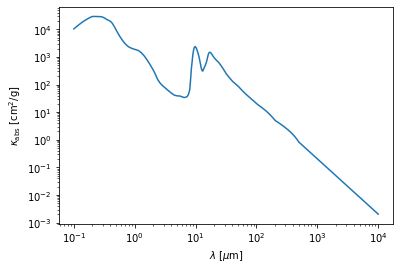

In [12]:
opac = analyze.readOpac(ext = ['silicate'])
plt.loglog(opac.wav[0], opac.kabs[0])
plt.xlabel(r'$\lambda$ [$\mu$m]')
plt.ylabel(r'$\kappa_{\rm abs}$ [cm$^2$/g]')
print(abs(opac.wav[0] - 1000).argmin())
print(opac.kabs[0][319])

In [16]:
data.getTau(axis = 'x', wav = 1000)
print(np.shape(data.taux))

IndexError: tuple index out of range

In [14]:
c = plt.contour(data.grid.x/natconst.au, np.pi/2.-data.grid.y, data.taux[:,:,0].T, [1.0],  colors='w', linestyles='solid')
plt.clabel(c, inline=1, fontsize=10)

IndexError: too many indices for array: array is 1-dimensional, but 3 were indexed

In [8]:
import shelve

with shelve.open('RadmcDB', 'c') as f:
    f['sigmad_list'] = sigmad_list
    f['temp_list'] = temp_list
    f['NoPertTemp'] = NoPertTemp
    f['data'] = data 
    
f.close()

In [ ]:
import shelve
f = shelve.open('RadmcDB')

sigmad_list = f['sigmad_list']
temp_list = f['temp_list']
NoPertTemp = f['NoPertTemp']
data = f['data']

/tmp/ipykernel_207/1745648413.py:24: RuntimeWarning: divide by zero encountered in true_divide
  Z = sp.ndimage.filters.gaussian_filter((100*(temp_list[i][j] - NoPertTemp) / NoPertTemp), 2)
/home/evan/anaconda3/lib/python3.9/site-packages/mpl_toolkits/mplot3d/proj3d.py:109: RuntimeWarning: invalid value encountered in true_divide
  txs, tys, tzs = vecw[0]/w, vecw[1]/w, vecw[2]/w


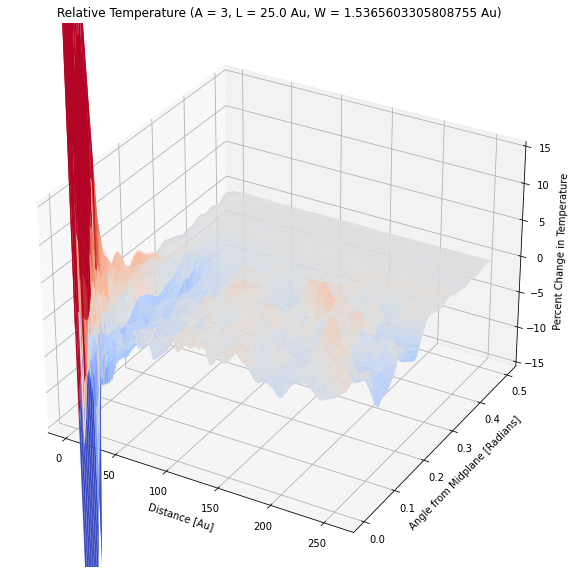

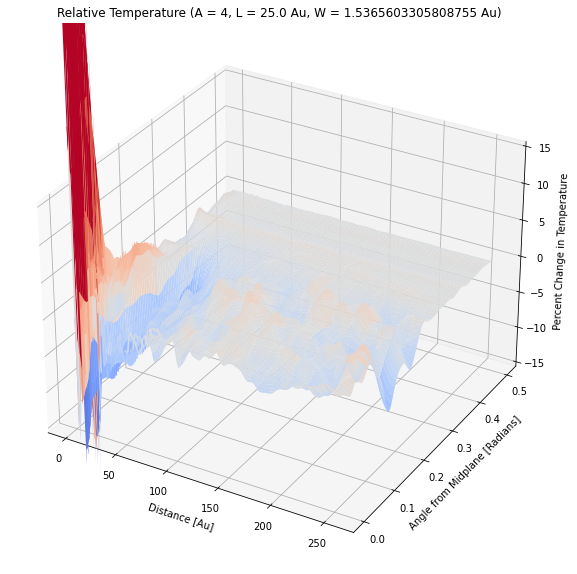

/tmp/ipykernel_207/1745648413.py:24: RuntimeWarning: invalid value encountered in true_divide
  Z = sp.ndimage.filters.gaussian_filter((100*(temp_list[i][j] - NoPertTemp) / NoPertTemp), 2)


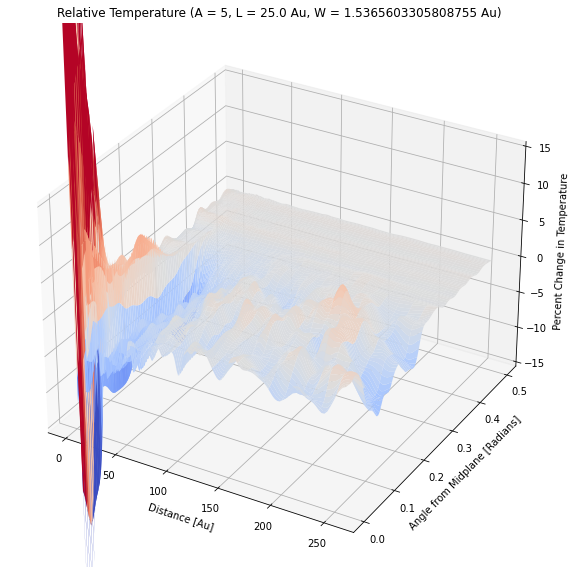

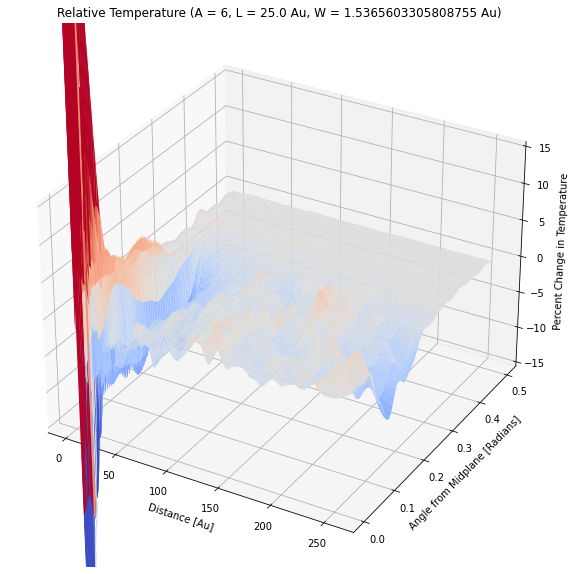

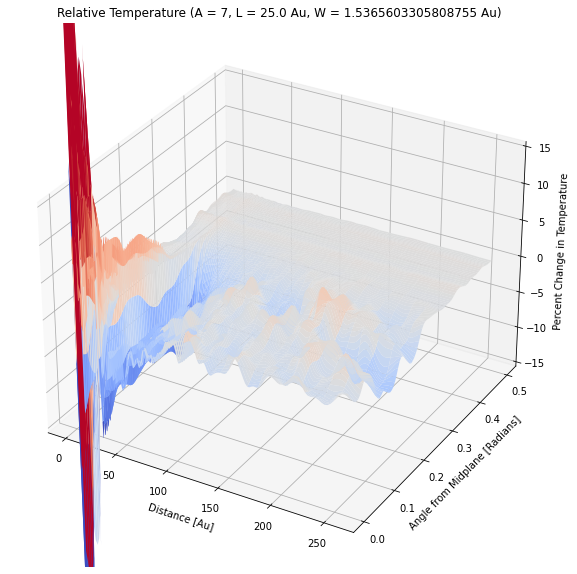

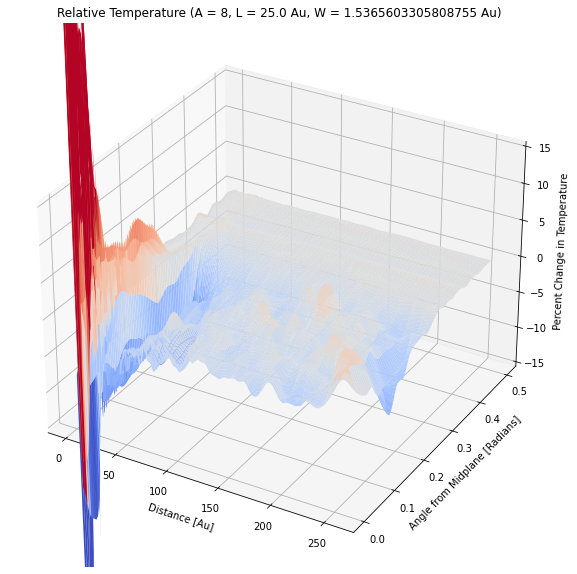

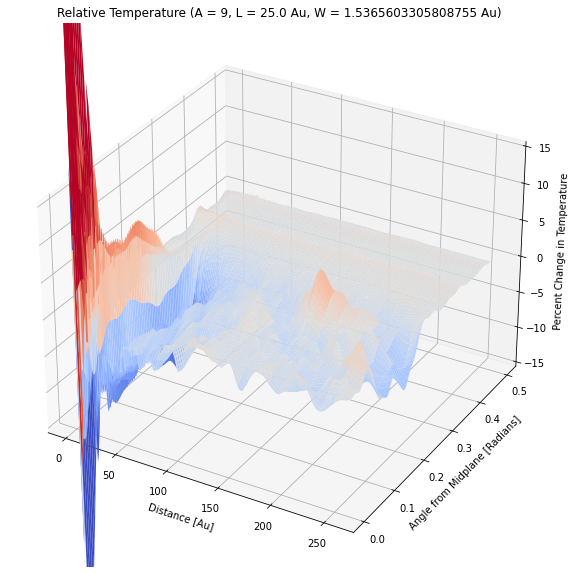

...

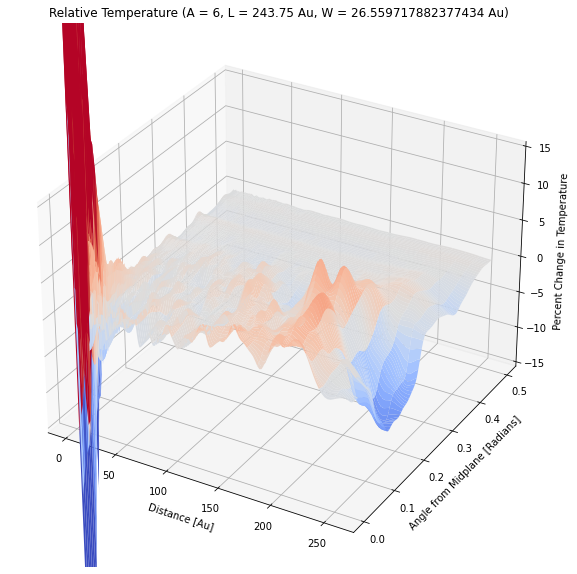

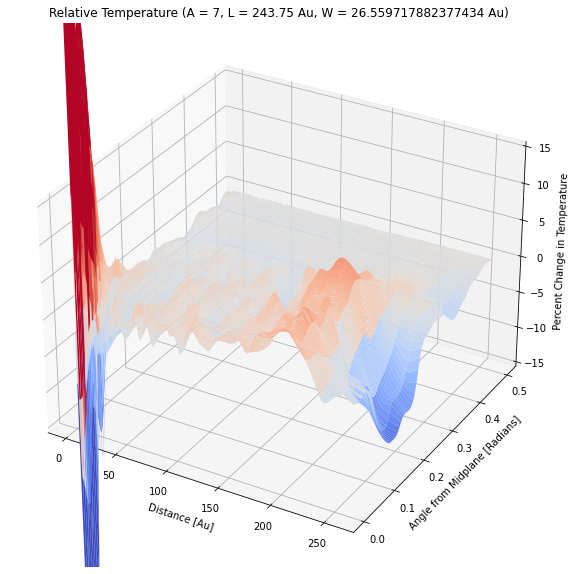

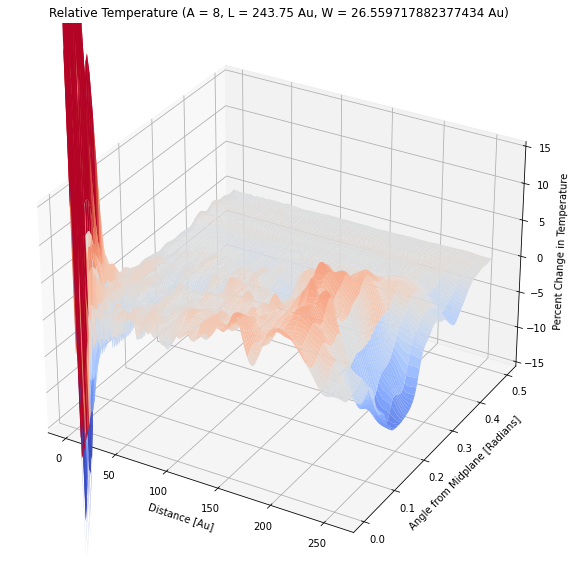

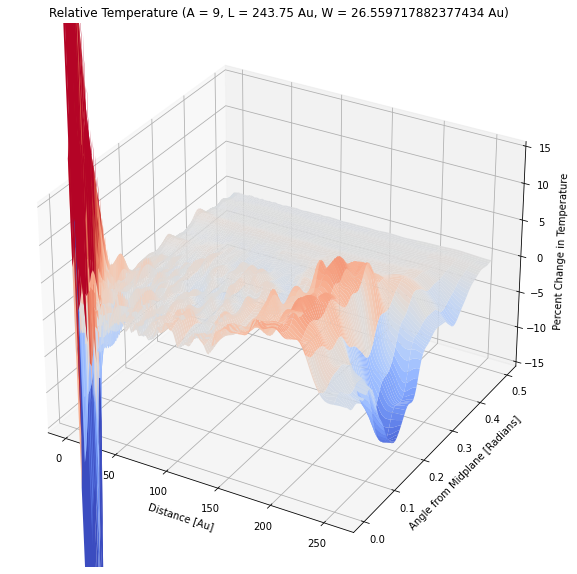

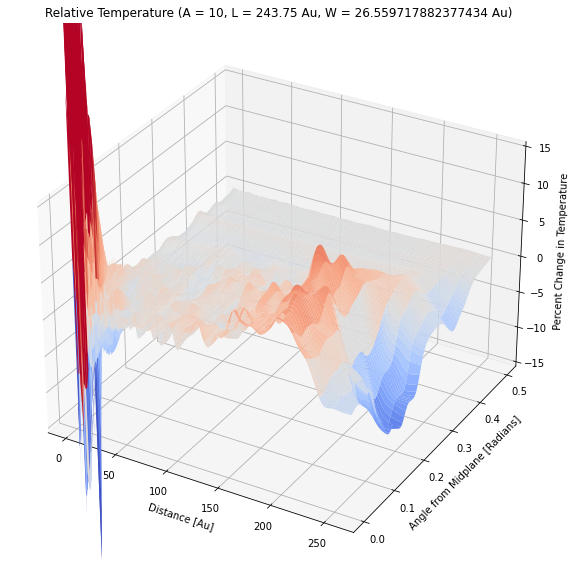

In [9]:
#Creating 3D Relative Temperature Plots
from matplotlib.pyplot import cm
from scipy import ndimage
amp_initial, amp_final, loc_initial, loc_final, a_step, l_step = 3, 11, 25*au, 275*au, 1, 31.25*au
for i in range(0, int((loc_final - loc_initial) / l_step)):
    for j in range(0, int((amp_final - amp_initial) / a_step)):

        x = data.grid.x/natconst.au
        l = i*l_step + loc_initial
        #The index of X which corresponds to the value in X closest to the location of the perturbation
        l_index = np.abs(x - (l / au)).argmin()
        width = hp[l_index]
        
        fig = plt.figure(figsize = (10,10))
        ax = plt.axes(projection='3d')
        ax.set_title('Relative Temperature (A = '+str(j*a_step + amp_initial)+', L = '+str((i*l_step + loc_initial)/au)+' Au, W = '+str(width / au)+' Au)')
        ax.set_xlabel('Distance [Au]')
        ax.set_ylabel('Angle from Midplane [Radians]')
        ax.set_zlabel('Percent Change in Temperature')
        ax.set_zlim(-15, 15)

        X, Y = np.meshgrid(x, np.pi/2. - data.grid.y)
        #Z = sp.ndimage.filters.gaussian_filter(np.transpose(np.transpose(temp_list[i][j])[AU_to_index:]), 1.25)
        Z = sp.ndimage.filters.gaussian_filter((100*(temp_list[i][j] - NoPertTemp) / NoPertTemp), 2)
        ax.plot_surface(X, Y, Z, vmin = -15, vmax = 15, rcount = 100, ccount = 100, edgecolor = 'none', cmap = cm.coolwarm)
        plt.show()
                

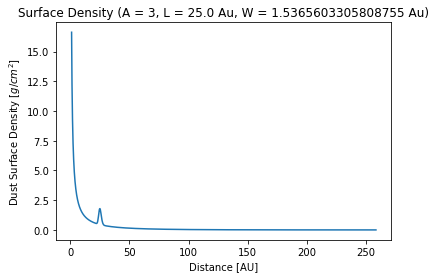

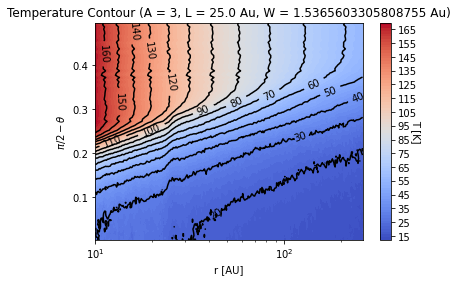

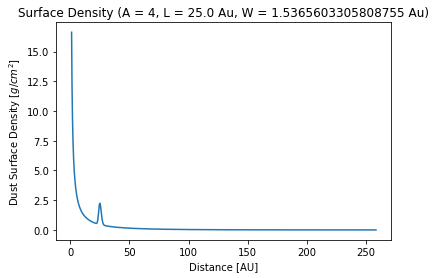

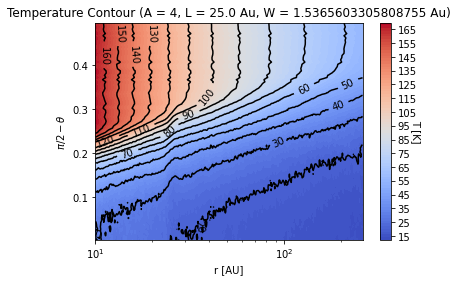

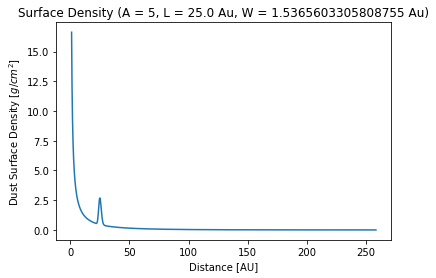

...

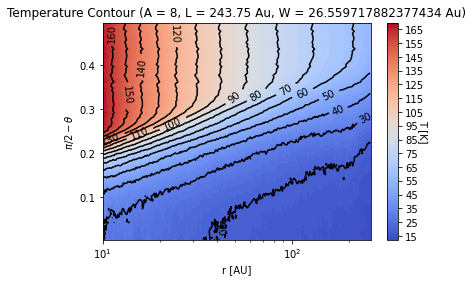

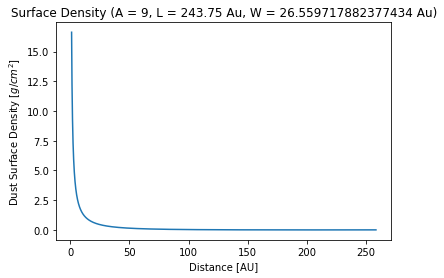

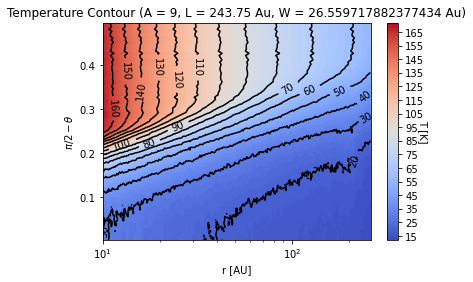

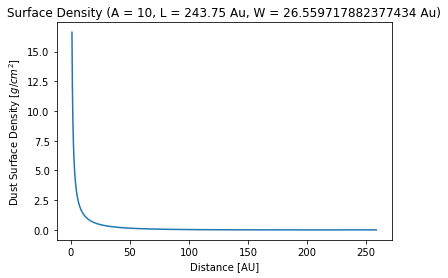

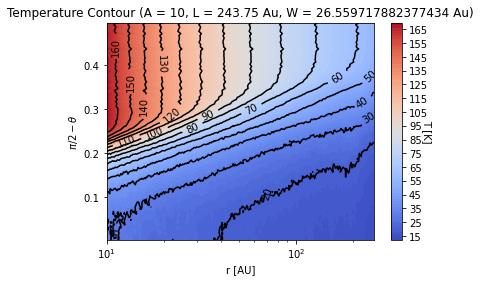

In [9]:
#Creating Surface Density and Temperature Contour Plots
from matplotlib.pyplot import cm
from scipy import ndimage
amp_initial, amp_final, loc_initial, loc_final, a_step, l_step = 3, 11, 25*au, 275*au, 1, 31.25*au
for i in range(0, int((loc_final - loc_initial) / l_step)):
    for j in range(0, int((amp_final - amp_initial) / a_step)):
        x = data.grid.x/natconst.au
        l = i*l_step + loc_initial
        #The index of X which corresponds to the value in X closest to 10 AU
        AU_to_index = np.abs(x - 10).argmin()
        #The index of X which corresponds to the value in X closest to the location of the perturbation
        l_index = np.abs(x - (l / au)).argmin()
        width = hp[l_index]
        
        plt.plot(x, sigmad_list[i][j])
        plt.title('Surface Density (A = '+str(j*a_step + amp_initial)+', L = '+str((i*l_step + loc_initial)/au)+' Au, W = '+str(width / au)+' Au)')
        plt.xlabel('Distance [AU]')
        plt.ylabel('Dust Surface Density [$g/cm^2$]')
        plt.show()

        fig, ax = plt.subplots()
        c = ax.contourf(x[AU_to_index:], np.pi/2.-data.grid.y, np.transpose(np.transpose(temp_list[i][j])[AU_to_index:]), 100, cmap = cm.coolwarm)
        ax.set_xlabel('r [AU]')
        ax.set_ylabel(r'$\pi/2-\theta$')
        ax.set_title('Temperature Contour (A = '+str(j*a_step + amp_initial)+', L = '+str((i*l_step + loc_initial)/au)+' Au, W = '+str(width / au)+' Au)')
        ax.set_xscale('log')
        ax.set_xlim(10, 260)
        Ticks = np.linspace(15, 185, 18)
        cb = plt.colorbar(c, ticks = Ticks)
        cb.set_label('T [K]', rotation=270.)

        c = ax.contour(x[AU_to_index:], np.pi/2.-data.grid.y, np.transpose(np.transpose(temp_list[i][j])[AU_to_index:]), 15,  colors='k', linestyles='solid')
        ax.clabel(c, inline=1, fontsize=10)
        plt.show()
            


/tmp/ipykernel_171/1076665847.py:52: RuntimeWarning: divide by zero encountered in true_divide
  T_for_mean[k + 20] = 100*(temp_list[i][j][k] - NoPertTemp[k]) / NoPertTemp[k]


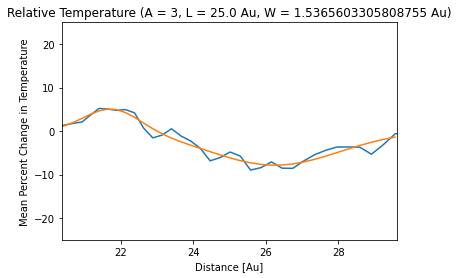

/tmp/ipykernel_171/1076665847.py:52: RuntimeWarning: divide by zero encountered in true_divide
  T_for_mean[k + 20] = 100*(temp_list[i][j][k] - NoPertTemp[k]) / NoPertTemp[k]


[ 5.39249205 21.76812088  0.76828017 -7.85020377 26.25234123  1.77803235]
Fit Equation: 5.39exp(-(R - 21.8)**2 / 2*0.768**2) + -7.85exp(-(R - 26.3)**2 / 2*1.78**2)
Maximum Value: 5.220303837126967
276
Minimum Value: -8.962742763307292
292


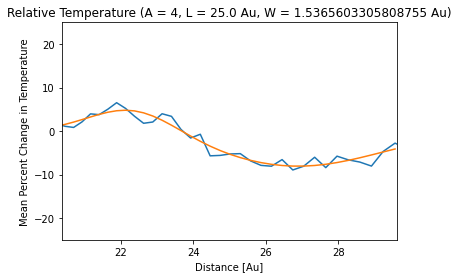

[ 5.84544229 22.34109146  1.19227367 -8.0719645  26.88539825  2.3048405 ]
Fit Equation: 5.85exp(-(R - 22.3)**2 / 2*1.19**2) + -8.07exp(-(R - 26.9)**2 / 2*2.3**2)
Maximum Value: 6.524772196562313
278
Minimum Value: -8.94161969834102
296


/tmp/ipykernel_171/1076665847.py:52: RuntimeWarning: divide by zero encountered in true_divide
  T_for_mean[k + 20] = 100*(temp_list[i][j][k] - NoPertTemp[k]) / NoPertTemp[k]
/tmp/ipykernel_171/1076665847.py:52: RuntimeWarning: invalid value encountered in true_divide
  T_for_mean[k + 20] = 100*(temp_list[i][j][k] - NoPertTemp[k]) / NoPertTemp[k]


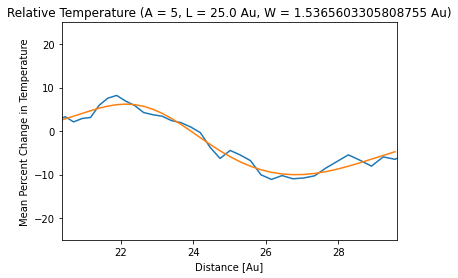

[  7.84383724  22.50225663   1.47843518 -10.15081705  26.71887468
   2.3048405 ]
Fit Equation: 7.84exp(-(R - 22.5)**2 / 2*1.48**2) + -10.2exp(-(R - 26.7)**2 / 2*2.3**2)
Maximum Value: 8.19706162822627
278
Minimum Value: -11.114719504796993
294


/tmp/ipykernel_171/1076665847.py:52: RuntimeWarning: divide by zero encountered in true_divide
  T_for_mean[k + 20] = 100*(temp_list[i][j][k] - NoPertTemp[k]) / NoPertTemp[k]


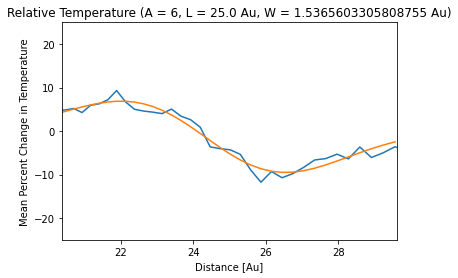

[ 11.64629943  23.19189724   2.14019817 -14.0458257   25.68101719
   2.11682151]
Fit Equation: 11.6exp(-(R - 23.2)**2 / 2*2.14**2) + -14.0exp(-(R - 25.7)**2 / 2*2.12**2)
Maximum Value: 9.317039545448255
278
Minimum Value: -11.757178920746895
293


/tmp/ipykernel_171/1076665847.py:52: RuntimeWarning: divide by zero encountered in true_divide
  T_for_mean[k + 20] = 100*(temp_list[i][j][k] - NoPertTemp[k]) / NoPertTemp[k]
/tmp/ipykernel_171/1076665847.py:52: RuntimeWarning: invalid value encountered in true_divide
  T_for_mean[k + 20] = 100*(temp_list[i][j][k] - NoPertTemp[k]) / NoPertTemp[k]


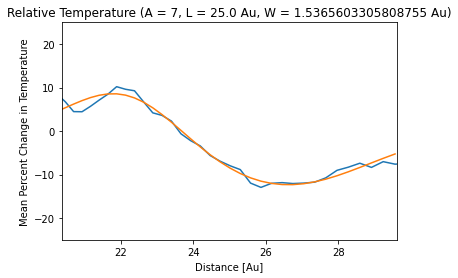

[ 10.28933869  22.08744494   1.49252861 -12.44424299  26.53570404
   2.3048405 ]
Fit Equation: 10.3exp(-(R - 22.1)**2 / 2*1.49**2) + -12.4exp(-(R - 26.5)**2 / 2*2.3**2)
Maximum Value: 10.208770808778885
278
Minimum Value: -12.948151002859907
293


/tmp/ipykernel_171/1076665847.py:52: RuntimeWarning: divide by zero encountered in true_divide
  T_for_mean[k + 20] = 100*(temp_list[i][j][k] - NoPertTemp[k]) / NoPertTemp[k]
/tmp/ipykernel_171/1076665847.py:52: RuntimeWarning: invalid value encountered in true_divide
  T_for_mean[k + 20] = 100*(temp_list[i][j][k] - NoPertTemp[k]) / NoPertTemp[k]


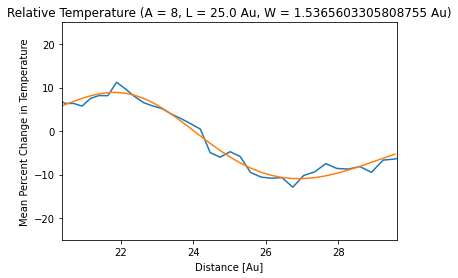

[ 10.22477556  22.14093011   1.70896978 -11.1874273   26.74430113
   2.3048405 ]
Fit Equation: 10.2exp(-(R - 22.1)**2 / 2*1.71**2) + -11.2exp(-(R - 26.7)**2 / 2*2.3**2)
Maximum Value: 11.230534644717409
278
Minimum Value: -12.906051890896872
296


/tmp/ipykernel_171/1076665847.py:52: RuntimeWarning: divide by zero encountered in true_divide
  T_for_mean[k + 20] = 100*(temp_list[i][j][k] - NoPertTemp[k]) / NoPertTemp[k]


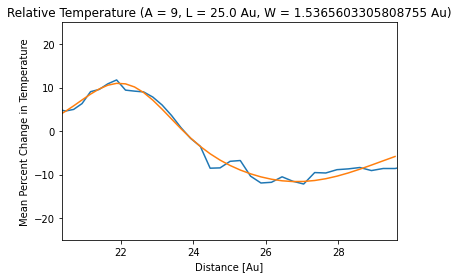

[ 12.29603624  22.09199666   1.17198841 -11.62559343  26.85701259
   2.3048405 ]
Fit Equation: 12.3exp(-(R - 22.1)**2 / 2*1.17**2) + -11.6exp(-(R - 26.9)**2 / 2*2.3**2)
Maximum Value: 11.758139558811468
278
Minimum Value: -12.174213233645963
297


/tmp/ipykernel_171/1076665847.py:52: RuntimeWarning: divide by zero encountered in true_divide
  T_for_mean[k + 20] = 100*(temp_list[i][j][k] - NoPertTemp[k]) / NoPertTemp[k]
/tmp/ipykernel_171/1076665847.py:52: RuntimeWarning: invalid value encountered in true_divide
  T_for_mean[k + 20] = 100*(temp_list[i][j][k] - NoPertTemp[k]) / NoPertTemp[k]


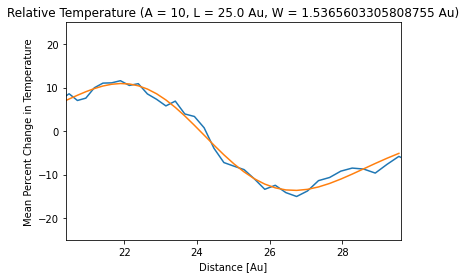

[ 14.47631798  22.51572813   1.89253642 -15.32672053  26.15365369
   2.3048405 ]
Fit Equation: 14.5exp(-(R - 22.5)**2 / 2*1.89**2) + -15.3exp(-(R - 26.2)**2 / 2*2.3**2)
Maximum Value: 11.581054384125288
278
Minimum Value: -15.039774636326923
296


/tmp/ipykernel_171/1076665847.py:52: RuntimeWarning: divide by zero encountered in true_divide
  T_for_mean[k + 20] = 100*(temp_list[i][j][k] - NoPertTemp[k]) / NoPertTemp[k]
/tmp/ipykernel_171/1076665847.py:52: RuntimeWarning: invalid value encountered in true_divide
  T_for_mean[k + 20] = 100*(temp_list[i][j][k] - NoPertTemp[k]) / NoPertTemp[k]


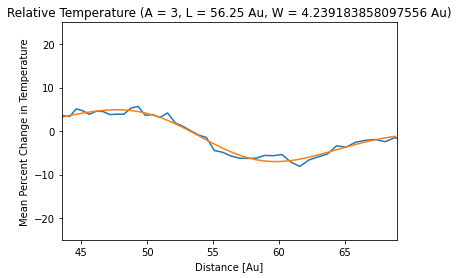

[ 7.10842165 50.36987042  5.70794413 -9.32489314 58.03917212  5.37185183]
Fit Equation: 7.11exp(-(R - 50.4)**2 / 2*5.71**2) + -9.32exp(-(R - 58.0)**2 / 2*5.37**2)
Maximum Value: 5.686737323950911
351
Minimum Value: -8.137584140685153
371


/tmp/ipykernel_171/1076665847.py:52: RuntimeWarning: divide by zero encountered in true_divide
  T_for_mean[k + 20] = 100*(temp_list[i][j][k] - NoPertTemp[k]) / NoPertTemp[k]


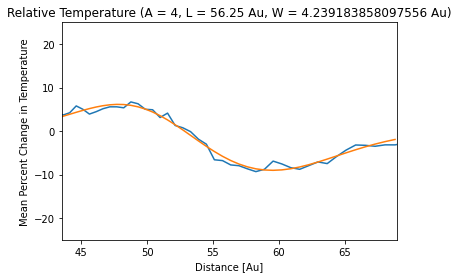

[ 8.38053716 49.28208928  4.48606255 -9.81673307 58.43159069  5.7645137 ]
Fit Equation: 8.38exp(-(R - 49.3)**2 / 2*4.49**2) + -9.82exp(-(R - 58.4)**2 / 2*5.76**2)
Maximum Value: 6.704429727073679
350
Minimum Value: -9.321523978404798
366


/tmp/ipykernel_171/1076665847.py:52: RuntimeWarning: divide by zero encountered in true_divide
  T_for_mean[k + 20] = 100*(temp_list[i][j][k] - NoPertTemp[k]) / NoPertTemp[k]
/tmp/ipykernel_171/1076665847.py:52: RuntimeWarning: invalid value encountered in true_divide
  T_for_mean[k + 20] = 100*(temp_list[i][j][k] - NoPertTemp[k]) / NoPertTemp[k]


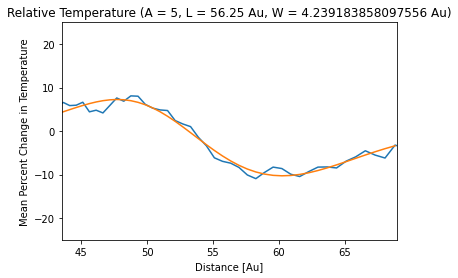

[ 10.11830076  49.29514583   4.80193566 -11.25214983  58.99437818
   6.34802343]
Fit Equation: 10.1exp(-(R - 49.3)**2 / 2*4.8**2) + -11.3exp(-(R - 59.0)**2 / 2*6.35**2)
Maximum Value: 8.094640607109834
350
Minimum Value: -10.939851799097744
366


/tmp/ipykernel_171/1076665847.py:52: RuntimeWarning: divide by zero encountered in true_divide
  T_for_mean[k + 20] = 100*(temp_list[i][j][k] - NoPertTemp[k]) / NoPertTemp[k]
/tmp/ipykernel_171/1076665847.py:52: RuntimeWarning: invalid value encountered in true_divide
  T_for_mean[k + 20] = 100*(temp_list[i][j][k] - NoPertTemp[k]) / NoPertTemp[k]


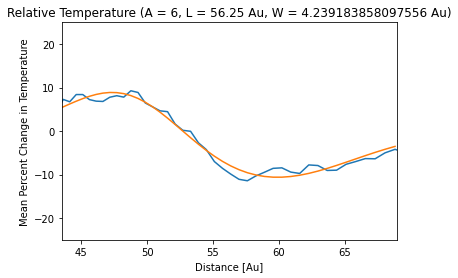

[ 11.03646429  48.27242364   4.27204419 -10.9464538   59.25751088
   6.35877579]
Fit Equation: 11.0exp(-(R - 48.3)**2 / 2*4.27**2) + -10.9exp(-(R - 59.3)**2 / 2*6.36**2)
Maximum Value: 9.272030122959366
350
Minimum Value: -11.426773892891191
365


/tmp/ipykernel_171/1076665847.py:52: RuntimeWarning: divide by zero encountered in true_divide
  T_for_mean[k + 20] = 100*(temp_list[i][j][k] - NoPertTemp[k]) / NoPertTemp[k]
/tmp/ipykernel_171/1076665847.py:52: RuntimeWarning: invalid value encountered in true_divide
  T_for_mean[k + 20] = 100*(temp_list[i][j][k] - NoPertTemp[k]) / NoPertTemp[k]


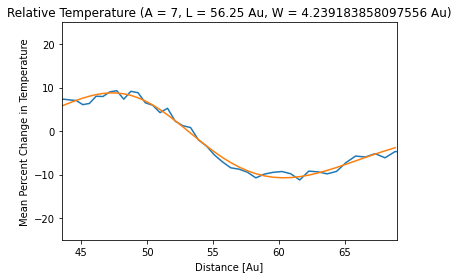

[ 10.96793821  48.52669783   4.73951195 -11.34239138  59.46616552
   6.35877579]
Fit Equation: 11.0exp(-(R - 48.5)**2 / 2*4.74**2) + -11.3exp(-(R - 59.5)**2 / 2*6.36**2)
Maximum Value: 9.286583800510071
348
Minimum Value: -11.246848684090354
371


/tmp/ipykernel_171/1076665847.py:52: RuntimeWarning: divide by zero encountered in true_divide
  T_for_mean[k + 20] = 100*(temp_list[i][j][k] - NoPertTemp[k]) / NoPertTemp[k]
/tmp/ipykernel_171/1076665847.py:52: RuntimeWarning: invalid value encountered in true_divide
  T_for_mean[k + 20] = 100*(temp_list[i][j][k] - NoPertTemp[k]) / NoPertTemp[k]


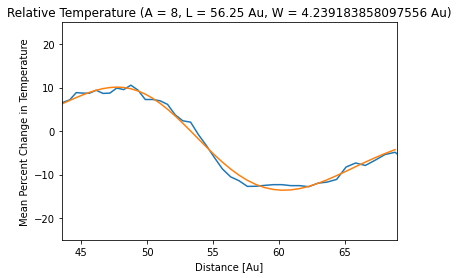

[ 13.19621899  49.18639066   4.91046872 -14.85493185  59.2101368
   6.0950418 ]
Fit Equation: 13.2exp(-(R - 49.2)**2 / 2*4.91**2) + -14.9exp(-(R - 59.2)**2 / 2*6.1**2)
Maximum Value: 10.55697518968656
350
Minimum Value: -12.793545844236263
372


/tmp/ipykernel_171/1076665847.py:52: RuntimeWarning: divide by zero encountered in true_divide
  T_for_mean[k + 20] = 100*(temp_list[i][j][k] - NoPertTemp[k]) / NoPertTemp[k]


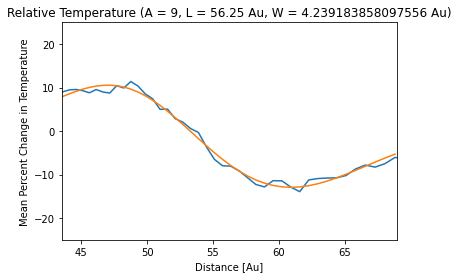

[ 12.51550509  48.17087984   5.15394322 -13.63575533  60.08649906
   6.35877579]
Fit Equation: 12.5exp(-(R - 48.2)**2 / 2*5.15**2) + -13.6exp(-(R - 60.1)**2 / 2*6.36**2)
Maximum Value: 11.39562865445638
350
Minimum Value: -13.923183733643459
371


/tmp/ipykernel_171/1076665847.py:52: RuntimeWarning: divide by zero encountered in true_divide
  T_for_mean[k + 20] = 100*(temp_list[i][j][k] - NoPertTemp[k]) / NoPertTemp[k]


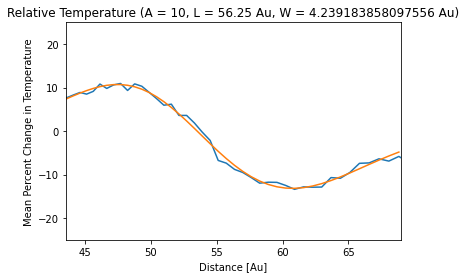

[ 13.69009831  48.96138874   5.22008835 -14.5529687   59.44199379
   6.32698351]
Fit Equation: 13.7exp(-(R - 49.0)**2 / 2*5.22**2) + -14.6exp(-(R - 59.4)**2 / 2*6.33**2)
Maximum Value: 10.952078645633582
348
Minimum Value: -13.394918438345487
370


/tmp/ipykernel_171/1076665847.py:52: RuntimeWarning: divide by zero encountered in true_divide
  T_for_mean[k + 20] = 100*(temp_list[i][j][k] - NoPertTemp[k]) / NoPertTemp[k]


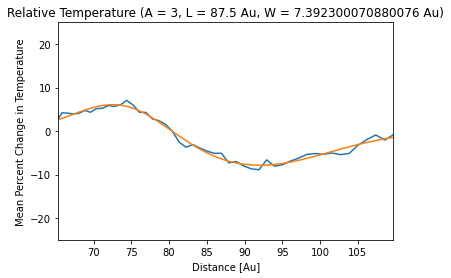

[ 7.51092818 73.82898287  6.14055909 -7.96100574 91.46248686  9.86347007]
Fit Equation: 7.51exp(-(R - 73.8)**2 / 2*6.14**2) + -7.96exp(-(R - 91.5)**2 / 2*9.86**2)
Maximum Value: 7.068511984687421
388
Minimum Value: -8.887913696481634
407


/tmp/ipykernel_171/1076665847.py:52: RuntimeWarning: divide by zero encountered in true_divide
  T_for_mean[k + 20] = 100*(temp_list[i][j][k] - NoPertTemp[k]) / NoPertTemp[k]


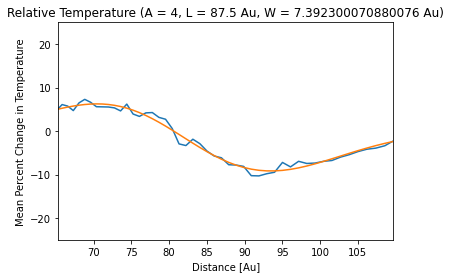

[  9.04336909  74.25200905   9.60563918 -10.77840937  90.47796532
  11.08845011]
Fit Equation: 9.04exp(-(R - 74.3)**2 / 2*9.61**2) + -10.8exp(-(R - 90.5)**2 / 2*11.1**2)
Maximum Value: 7.29530468366182
381
Minimum Value: -10.305625535623829
407


/tmp/ipykernel_171/1076665847.py:52: RuntimeWarning: divide by zero encountered in true_divide
  T_for_mean[k + 20] = 100*(temp_list[i][j][k] - NoPertTemp[k]) / NoPertTemp[k]


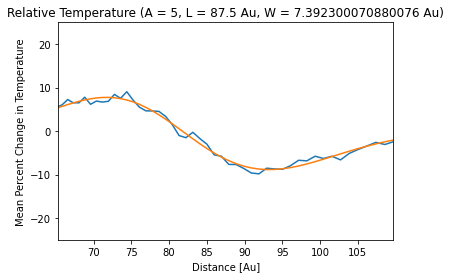

/tmp/ipykernel_171/1076665847.py:52: RuntimeWarning: divide by zero encountered in true_divide
  T_for_mean[k + 20] = 100*(temp_list[i][j][k] - NoPertTemp[k]) / NoPertTemp[k]
/tmp/ipykernel_171/1076665847.py:52: RuntimeWarning: invalid value encountered in true_divide
  T_for_mean[k + 20] = 100*(temp_list[i][j][k] - NoPertTemp[k]) / NoPertTemp[k]


[ 11.31031367  74.80319165   8.81363451 -10.67535807  89.63774874
  11.07867608]
Fit Equation: 11.3exp(-(R - 74.8)**2 / 2*8.81**2) + -10.7exp(-(R - 89.6)**2 / 2*11.1**2)
Maximum Value: 9.048250936827362
388
Minimum Value: -9.833756978213188
407


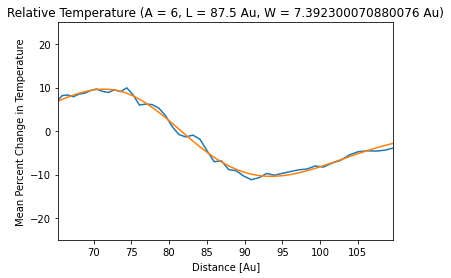

[ 12.42035954  73.60998335   8.44763589 -11.45010765  91.12164967
  11.08845011]
Fit Equation: 12.4exp(-(R - 73.6)**2 / 2*8.45**2) + -11.5exp(-(R - 91.1)**2 / 2*11.1**2)
Maximum Value: 9.936287642292779
388
Minimum Value: -11.1827348989597
406


/tmp/ipykernel_171/1076665847.py:52: RuntimeWarning: divide by zero encountered in true_divide
  T_for_mean[k + 20] = 100*(temp_list[i][j][k] - NoPertTemp[k]) / NoPertTemp[k]


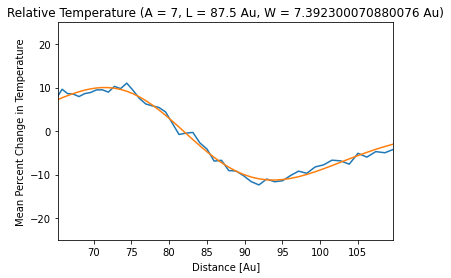

[ 13.61076438  74.3423012    9.01523903 -13.09476484  90.68819814
  11.08845011]
Fit Equation: 13.6exp(-(R - 74.3)**2 / 2*9.02**2) + -13.1exp(-(R - 90.7)**2 / 2*11.1**2)
Maximum Value: 11.02211647622611
388
Minimum Value: -12.381797766332317
407


/tmp/ipykernel_171/1076665847.py:52: RuntimeWarning: divide by zero encountered in true_divide
  T_for_mean[k + 20] = 100*(temp_list[i][j][k] - NoPertTemp[k]) / NoPertTemp[k]


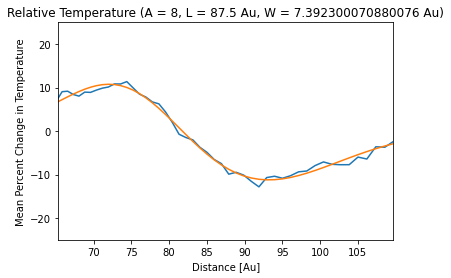

[ 14.06443828  74.03031299   7.85929266 -12.18997989  90.93163216
  11.08845011]
Fit Equation: 14.1exp(-(R - 74.0)**2 / 2*7.86**2) + -12.2exp(-(R - 90.9)**2 / 2*11.1**2)
Maximum Value: 11.374937929603757
388
Minimum Value: -12.824962124778574
407


/tmp/ipykernel_171/1076665847.py:52: RuntimeWarning: divide by zero encountered in true_divide
  T_for_mean[k + 20] = 100*(temp_list[i][j][k] - NoPertTemp[k]) / NoPertTemp[k]
/tmp/ipykernel_171/1076665847.py:52: RuntimeWarning: invalid value encountered in true_divide
  T_for_mean[k + 20] = 100*(temp_list[i][j][k] - NoPertTemp[k]) / NoPertTemp[k]


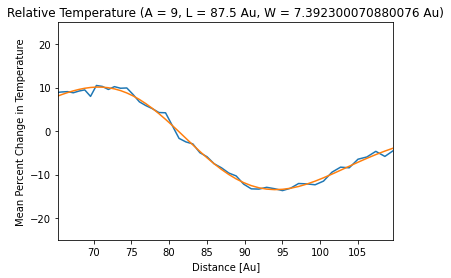

[ 13.10583297  73.62524002   9.46135398 -15.06557474  91.75362607
  10.9469587 ]
Fit Equation: 13.1exp(-(R - 73.6)**2 / 2*9.46**2) + -15.1exp(-(R - 91.8)**2 / 2*10.9**2)
Maximum Value: 10.484666376323236
383
Minimum Value: -13.685670988665734
410


/tmp/ipykernel_171/1076665847.py:52: RuntimeWarning: divide by zero encountered in true_divide
  T_for_mean[k + 20] = 100*(temp_list[i][j][k] - NoPertTemp[k]) / NoPertTemp[k]
/tmp/ipykernel_171/1076665847.py:52: RuntimeWarning: invalid value encountered in true_divide
  T_for_mean[k + 20] = 100*(temp_list[i][j][k] - NoPertTemp[k]) / NoPertTemp[k]


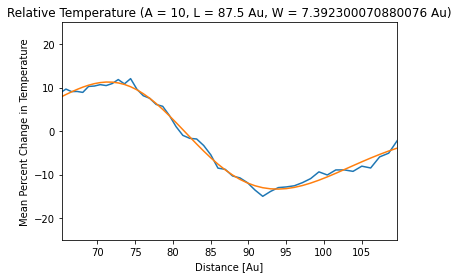

[ 14.43090207  73.66495725   8.37523756 -14.36866224  91.83859336
  11.08845011]
Fit Equation: 14.4exp(-(R - 73.7)**2 / 2*8.38**2) + -14.4exp(-(R - 91.8)**2 / 2*11.1**2)
Maximum Value: 12.060461365442208
388
Minimum Value: -15.000571791565335
407


/tmp/ipykernel_171/1076665847.py:52: RuntimeWarning: divide by zero encountered in true_divide
  T_for_mean[k + 20] = 100*(temp_list[i][j][k] - NoPertTemp[k]) / NoPertTemp[k]


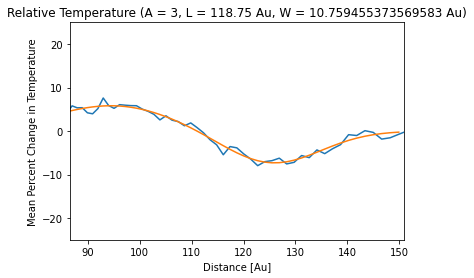

[  5.85581592  94.64518056  11.77214437  -7.48652589 125.53603659
   9.30983753]
Fit Equation: 5.86exp(-(R - 94.6)**2 / 2*11.8**2) + -7.49exp(-(R - 126.0)**2 / 2*9.31**2)
Maximum Value: 7.606376296427605
408
Minimum Value: -7.95271973752489
433


/tmp/ipykernel_171/1076665847.py:52: RuntimeWarning: divide by zero encountered in true_divide
  T_for_mean[k + 20] = 100*(temp_list[i][j][k] - NoPertTemp[k]) / NoPertTemp[k]


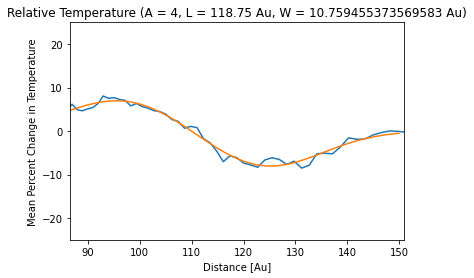

[  7.22425111  96.44663985  10.98057686  -8.30422142 124.37430684
  10.77744163]
Fit Equation: 7.22exp(-(R - 96.4)**2 / 2*11.0**2) + -8.3exp(-(R - 124.0)**2 / 2*10.8**2)
Maximum Value: 8.063105214670182
408
Minimum Value: -8.514545241757407
439


/tmp/ipykernel_171/1076665847.py:52: RuntimeWarning: divide by zero encountered in true_divide
  T_for_mean[k + 20] = 100*(temp_list[i][j][k] - NoPertTemp[k]) / NoPertTemp[k]


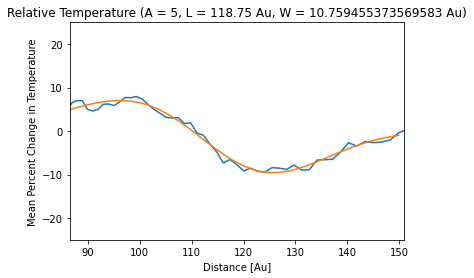

[  8.67462796 101.04873649  14.13026166 -11.80773008 122.64364463
  12.25901242]
Fit Equation: 8.67exp(-(R - 101.0)**2 / 2*14.1**2) + -11.8exp(-(R - 123.0)**2 / 2*12.3**2)
Maximum Value: 7.945763164575305
414
Minimum Value: -9.446184061717648
434


/tmp/ipykernel_171/1076665847.py:52: RuntimeWarning: divide by zero encountered in true_divide
  T_for_mean[k + 20] = 100*(temp_list[i][j][k] - NoPertTemp[k]) / NoPertTemp[k]


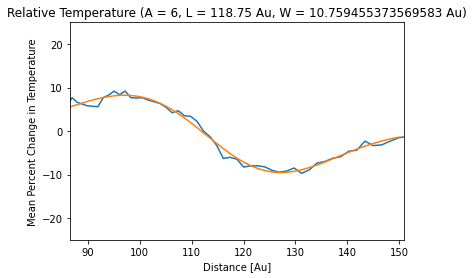

[ 10.24057194 101.89483796  14.25585821 -12.1457508  123.50918043
  12.78140143]
Fit Equation: 10.2exp(-(R - 102.0)**2 / 2*14.3**2) + -12.1exp(-(R - 124.0)**2 / 2*12.8**2)
Maximum Value: 9.203177488469247
412
Minimum Value: -9.716600640351917
439


/tmp/ipykernel_171/1076665847.py:52: RuntimeWarning: divide by zero encountered in true_divide
  T_for_mean[k + 20] = 100*(temp_list[i][j][k] - NoPertTemp[k]) / NoPertTemp[k]


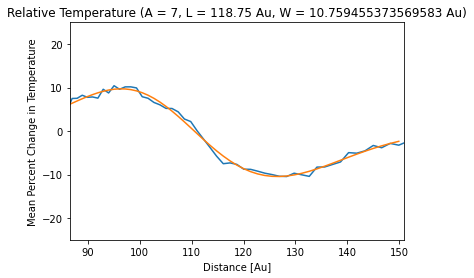

[ 13.04211006  99.91378843  11.8972726  -11.92922267 122.47279847
  15.24952998]
Fit Equation: 13.0exp(-(R - 99.9)**2 / 2*11.9**2) + -11.9exp(-(R - 122.0)**2 / 2*15.2**2)
Maximum Value: 10.433688047751362
410
Minimum Value: -10.450789837576421
437


/tmp/ipykernel_171/1076665847.py:52: RuntimeWarning: divide by zero encountered in true_divide
  T_for_mean[k + 20] = 100*(temp_list[i][j][k] - NoPertTemp[k]) / NoPertTemp[k]
/tmp/ipykernel_171/1076665847.py:52: RuntimeWarning: invalid value encountered in true_divide
  T_for_mean[k + 20] = 100*(temp_list[i][j][k] - NoPertTemp[k]) / NoPertTemp[k]


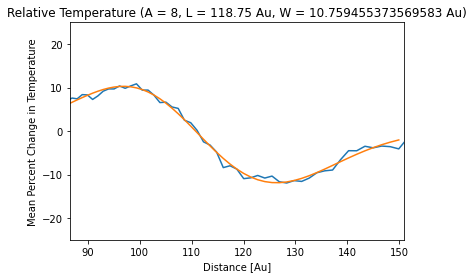

[ 13.57959017 100.83320916  12.30019028 -13.97699772 122.51053988
  13.98135505]
Fit Equation: 13.6exp(-(R - 101.0)**2 / 2*12.3**2) + -14.0exp(-(R - 123.0)**2 / 2*14.0**2)
Maximum Value: 10.86367213859171
414
Minimum Value: -11.939906127640656
437


/tmp/ipykernel_171/1076665847.py:52: RuntimeWarning: divide by zero encountered in true_divide
  T_for_mean[k + 20] = 100*(temp_list[i][j][k] - NoPertTemp[k]) / NoPertTemp[k]


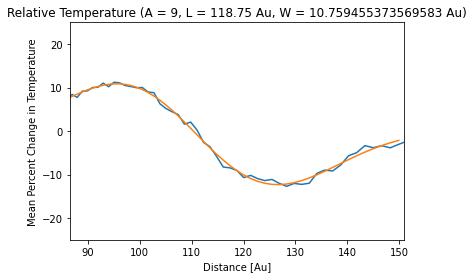

[ 12.53234411  98.29200572  12.41534916 -13.45192016 124.25718959
  13.40441931]
Fit Equation: 12.5exp(-(R - 98.3)**2 / 2*12.4**2) + -13.5exp(-(R - 124.0)**2 / 2*13.4**2)
Maximum Value: 11.23094149457129
410
Minimum Value: -12.706745931653902
437


/tmp/ipykernel_171/1076665847.py:52: RuntimeWarning: divide by zero encountered in true_divide
  T_for_mean[k + 20] = 100*(temp_list[i][j][k] - NoPertTemp[k]) / NoPertTemp[k]
/tmp/ipykernel_171/1076665847.py:52: RuntimeWarning: invalid value encountered in true_divide
  T_for_mean[k + 20] = 100*(temp_list[i][j][k] - NoPertTemp[k]) / NoPertTemp[k]


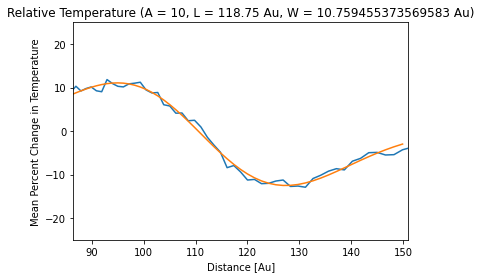

[ 14.80535551  99.92809183  14.15242733 -15.50626929 122.69067332
  15.04760414]
Fit Equation: 14.8exp(-(R - 99.9)**2 / 2*14.2**2) + -15.5exp(-(R - 123.0)**2 / 2*15.0**2)
Maximum Value: 11.844284408273966
408
Minimum Value: -12.914909384300083
439


/tmp/ipykernel_171/1076665847.py:52: RuntimeWarning: divide by zero encountered in true_divide
  T_for_mean[k + 20] = 100*(temp_list[i][j][k] - NoPertTemp[k]) / NoPertTemp[k]
/tmp/ipykernel_171/1076665847.py:52: RuntimeWarning: invalid value encountered in true_divide
  T_for_mean[k + 20] = 100*(temp_list[i][j][k] - NoPertTemp[k]) / NoPertTemp[k]


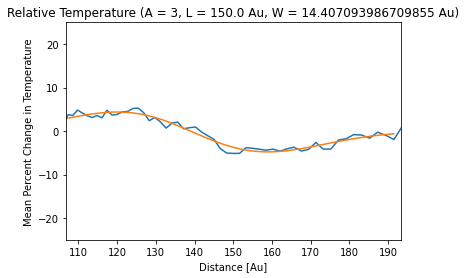

[  6.25554581 127.09535655  17.4464668   -6.41369317 152.02610028
  18.24723383]
Fit Equation: 6.26exp(-(R - 127.0)**2 / 2*17.4**2) + -6.41exp(-(R - 152.0)**2 / 2*18.2**2)
Maximum Value: 5.275758002262688
435
Minimum Value: -5.130954539728349
452


/tmp/ipykernel_171/1076665847.py:52: RuntimeWarning: divide by zero encountered in true_divide
  T_for_mean[k + 20] = 100*(temp_list[i][j][k] - NoPertTemp[k]) / NoPertTemp[k]


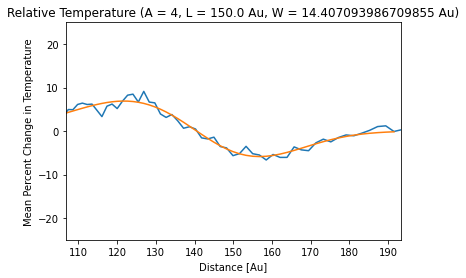

[  8.17571594 127.08267104  17.57709766  -8.30988062 151.82057726
  14.27628061]
Fit Equation: 8.18exp(-(R - 127.0)**2 / 2*17.6**2) + -8.31exp(-(R - 152.0)**2 / 2*14.3**2)
Maximum Value: 9.125175013985043
436
Minimum Value: -6.64790449637363
456


/tmp/ipykernel_171/1076665847.py:52: RuntimeWarning: divide by zero encountered in true_divide
  T_for_mean[k + 20] = 100*(temp_list[i][j][k] - NoPertTemp[k]) / NoPertTemp[k]


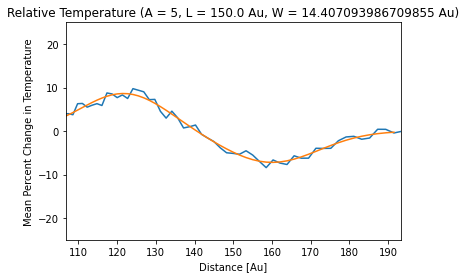

[  8.69746519 121.83179141  11.08248648  -7.22336719 159.89905039
  12.23731098]
Fit Equation: 8.7exp(-(R - 122.0)**2 / 2*11.1**2) + -7.22exp(-(R - 160.0)**2 / 2*12.2**2)
Maximum Value: 9.755890341260281
434
Minimum Value: -8.402704156219036
456


/tmp/ipykernel_171/1076665847.py:52: RuntimeWarning: invalid value encountered in true_divide
  T_for_mean[k + 20] = 100*(temp_list[i][j][k] - NoPertTemp[k]) / NoPertTemp[k]
/tmp/ipykernel_171/1076665847.py:52: RuntimeWarning: divide by zero encountered in true_divide
  T_for_mean[k + 20] = 100*(temp_list[i][j][k] - NoPertTemp[k]) / NoPertTemp[k]


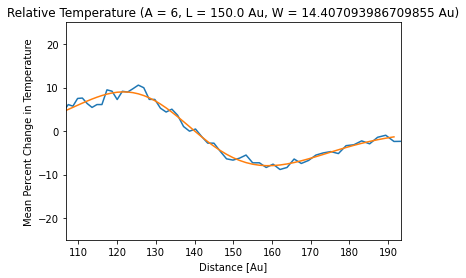

[ 12.17657211 125.7861811   14.81396473  -9.4235177  152.67624674
  19.61682902]
Fit Equation: 12.2exp(-(R - 126.0)**2 / 2*14.8**2) + -9.42exp(-(R - 153.0)**2 / 2*19.6**2)
Maximum Value: 10.570106946840435
435
Minimum Value: -8.835382111890377
458


/tmp/ipykernel_171/1076665847.py:52: RuntimeWarning: divide by zero encountered in true_divide
  T_for_mean[k + 20] = 100*(temp_list[i][j][k] - NoPertTemp[k]) / NoPertTemp[k]
/tmp/ipykernel_171/1076665847.py:52: RuntimeWarning: invalid value encountered in true_divide
  T_for_mean[k + 20] = 100*(temp_list[i][j][k] - NoPertTemp[k]) / NoPertTemp[k]


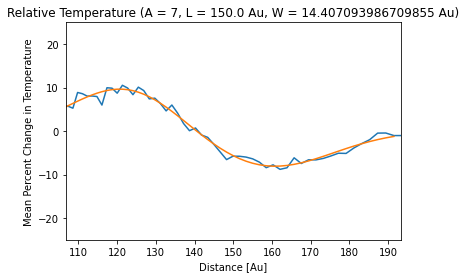

[ 10.23435848 122.18114188  14.10536526  -8.35675166 159.26496563
  16.44205983]
Fit Equation: 10.2exp(-(R - 122.0)**2 / 2*14.1**2) + -8.36exp(-(R - 159.0)**2 / 2*16.4**2)
Maximum Value: 10.531767456567902
432
Minimum Value: -8.797998337795418
458


/tmp/ipykernel_171/1076665847.py:52: RuntimeWarning: divide by zero encountered in true_divide
  T_for_mean[k + 20] = 100*(temp_list[i][j][k] - NoPertTemp[k]) / NoPertTemp[k]


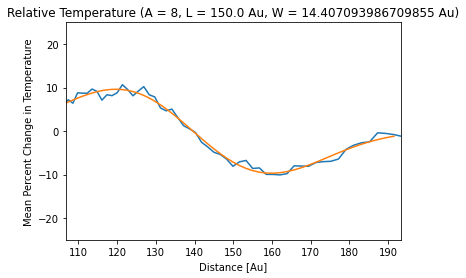

[ 10.48289177 122.22655446  15.91843312 -10.45609421 157.3721153
  16.35370499]
Fit Equation: 10.5exp(-(R - 122.0)**2 / 2*15.9**2) + -10.5exp(-(R - 157.0)**2 / 2*16.4**2)
Maximum Value: 10.663937469027303
432
Minimum Value: -10.076726664272824
458


/tmp/ipykernel_171/1076665847.py:52: RuntimeWarning: divide by zero encountered in true_divide
  T_for_mean[k + 20] = 100*(temp_list[i][j][k] - NoPertTemp[k]) / NoPertTemp[k]


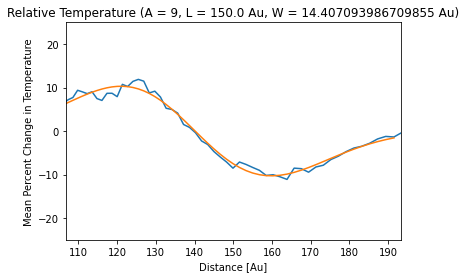

/tmp/ipykernel_171/1076665847.py:52: RuntimeWarning: divide by zero encountered in true_divide
  T_for_mean[k + 20] = 100*(temp_list[i][j][k] - NoPertTemp[k]) / NoPertTemp[k]
/tmp/ipykernel_171/1076665847.py:52: RuntimeWarning: invalid value encountered in true_divide
  T_for_mean[k + 20] = 100*(temp_list[i][j][k] - NoPertTemp[k]) / NoPertTemp[k]


[ 14.85944502 127.47670401  17.00012143 -13.79993677 152.21243631
  18.86200436]
Fit Equation: 14.9exp(-(R - 127.0)**2 / 2*17.0**2) + -13.8exp(-(R - 152.0)**2 / 2*18.9**2)
Maximum Value: 11.887556132455401
435
Minimum Value: -11.11184719830856
459


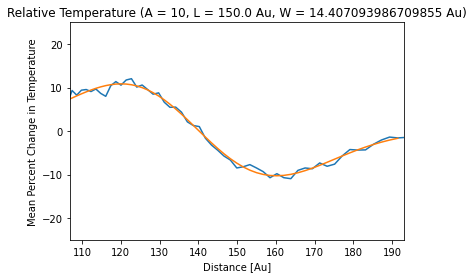

[ 14.73412007 126.3756306   17.79014475 -13.67872607 152.92774227
  18.81582614]
Fit Equation: 14.7exp(-(R - 126.0)**2 / 2*17.8**2) + -13.7exp(-(R - 153.0)**2 / 2*18.8**2)
Maximum Value: 12.044120316339507
433
Minimum Value: -10.942980856113339
459


/tmp/ipykernel_171/1076665847.py:52: RuntimeWarning: divide by zero encountered in true_divide
  T_for_mean[k + 20] = 100*(temp_list[i][j][k] - NoPertTemp[k]) / NoPertTemp[k]


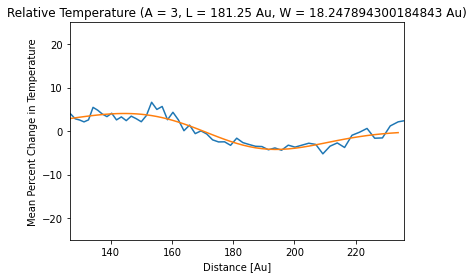

[  4.97615669 154.76664156  27.37184145  -6.30174802 187.80651741
  19.9240383 ]
Fit Equation: 4.98exp(-(R - 155.0)**2 / 2*27.4**2) + -6.3exp(-(R - 188.0)**2 / 2*19.9**2)
Maximum Value: 6.629095984425814
453
Minimum Value: -5.232323013426566
481


/tmp/ipykernel_171/1076665847.py:52: RuntimeWarning: divide by zero encountered in true_divide
  T_for_mean[k + 20] = 100*(temp_list[i][j][k] - NoPertTemp[k]) / NoPertTemp[k]


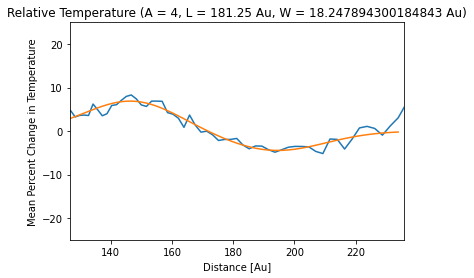

[  6.95468329 146.62436963  15.10756633  -4.498891   193.9904699
  16.17454703]
Fit Equation: 6.95exp(-(R - 147.0)**2 / 2*15.1**2) + -4.5exp(-(R - 194.0)**2 / 2*16.2**2)
Maximum Value: 8.308925338709464
449
Minimum Value: -5.171401393863886
481


/tmp/ipykernel_171/1076665847.py:52: RuntimeWarning: divide by zero encountered in true_divide
  T_for_mean[k + 20] = 100*(temp_list[i][j][k] - NoPertTemp[k]) / NoPertTemp[k]


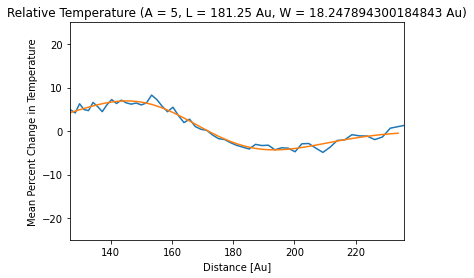

[  8.84298676 151.05068513  21.10661645  -6.12749251 182.79804786
  22.81002706]
Fit Equation: 8.84exp(-(R - 151.0)**2 / 2*21.1**2) + -6.13exp(-(R - 183.0)**2 / 2*22.8**2)
Maximum Value: 8.273130593180198
453
Minimum Value: -4.901994008597829
481


/tmp/ipykernel_171/1076665847.py:52: RuntimeWarning: divide by zero encountered in true_divide
  T_for_mean[k + 20] = 100*(temp_list[i][j][k] - NoPertTemp[k]) / NoPertTemp[k]


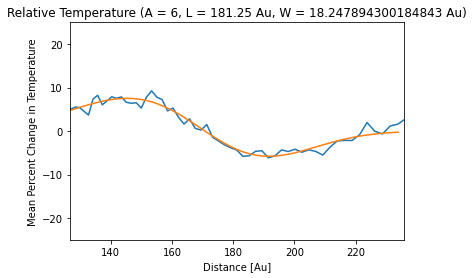

[  8.44426944 150.28807001  22.26409942  -7.67545623 185.7763083
  18.52946128]
Fit Equation: 8.44exp(-(R - 150.0)**2 / 2*22.3**2) + -7.68exp(-(R - 186.0)**2 / 2*18.5**2)
Maximum Value: 9.248887009787286
453
Minimum Value: -6.140364986970149
473


/tmp/ipykernel_171/1076665847.py:52: RuntimeWarning: divide by zero encountered in true_divide
  T_for_mean[k + 20] = 100*(temp_list[i][j][k] - NoPertTemp[k]) / NoPertTemp[k]


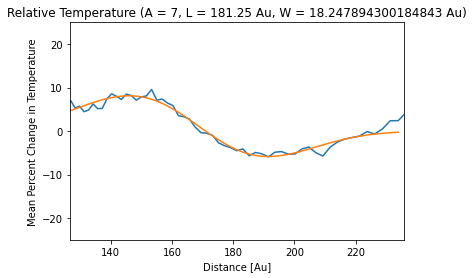

[  9.11384422 150.23468428  20.56313599  -7.42958653 185.55722919
  18.75861082]
Fit Equation: 9.11exp(-(R - 150.0)**2 / 2*20.6**2) + -7.43exp(-(R - 186.0)**2 / 2*18.8**2)
Maximum Value: 9.562497115289107
453
Minimum Value: -5.943669223007133
473


/tmp/ipykernel_171/1076665847.py:52: RuntimeWarning: divide by zero encountered in true_divide
  T_for_mean[k + 20] = 100*(temp_list[i][j][k] - NoPertTemp[k]) / NoPertTemp[k]
/tmp/ipykernel_171/1076665847.py:52: RuntimeWarning: invalid value encountered in true_divide
  T_for_mean[k + 20] = 100*(temp_list[i][j][k] - NoPertTemp[k]) / NoPertTemp[k]


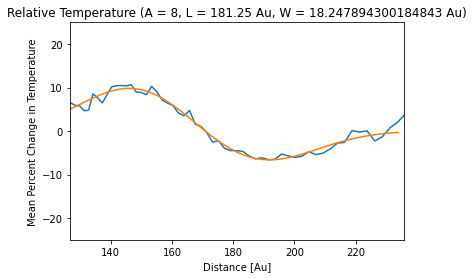

[ 10.28604208 147.65092388  17.64636382  -7.1572322  188.90523905
  18.00010829]
Fit Equation: 10.3exp(-(R - 148.0)**2 / 2*17.6**2) + -7.16exp(-(R - 189.0)**2 / 2*18.0**2)
Maximum Value: 10.661538325484939
449
Minimum Value: -6.578300378600217
473


/tmp/ipykernel_171/1076665847.py:52: RuntimeWarning: divide by zero encountered in true_divide
  T_for_mean[k + 20] = 100*(temp_list[i][j][k] - NoPertTemp[k]) / NoPertTemp[k]
/tmp/ipykernel_171/1076665847.py:52: RuntimeWarning: invalid value encountered in true_divide
  T_for_mean[k + 20] = 100*(temp_list[i][j][k] - NoPertTemp[k]) / NoPertTemp[k]


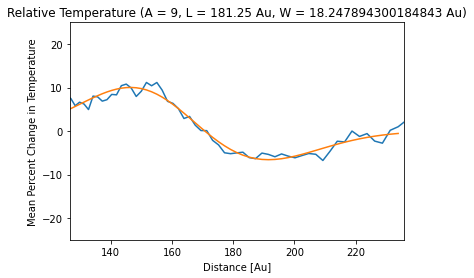

[ 12.48923277 151.03601327  18.82784384  -8.45123798 182.90628353
  21.80714096]
Fit Equation: 12.5exp(-(R - 151.0)**2 / 2*18.8**2) + -8.45exp(-(R - 183.0)**2 / 2*21.8**2)
Maximum Value: 11.176480474490438
452
Minimum Value: -6.760990380111656
481


/tmp/ipykernel_171/1076665847.py:52: RuntimeWarning: divide by zero encountered in true_divide
  T_for_mean[k + 20] = 100*(temp_list[i][j][k] - NoPertTemp[k]) / NoPertTemp[k]


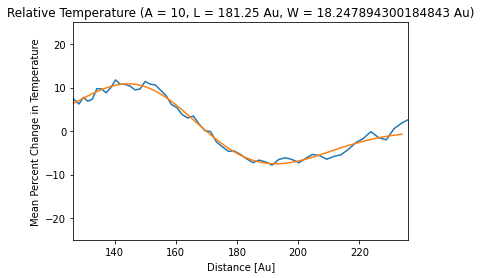

[ 11.71411496 146.67156201  18.43220501  -8.17750541 188.9715821
  20.42999296]
Fit Equation: 11.7exp(-(R - 147.0)**2 / 2*18.4**2) + -8.18exp(-(R - 189.0)**2 / 2*20.4**2)
Maximum Value: 11.77032192131121
445
Minimum Value: -7.826181196425059
473


/tmp/ipykernel_171/1076665847.py:52: RuntimeWarning: divide by zero encountered in true_divide
  T_for_mean[k + 20] = 100*(temp_list[i][j][k] - NoPertTemp[k]) / NoPertTemp[k]
/tmp/ipykernel_171/1076665847.py:52: RuntimeWarning: invalid value encountered in true_divide
  T_for_mean[k + 20] = 100*(temp_list[i][j][k] - NoPertTemp[k]) / NoPertTemp[k]


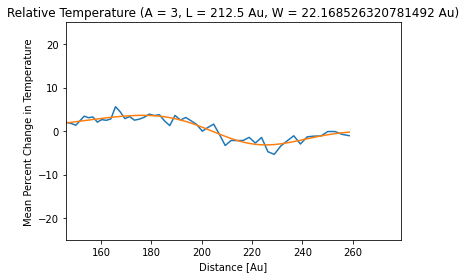

[  4.20426085 188.3847478   33.25278948  -5.62662246 220.65072894
  18.50884263]
Fit Equation: 4.2exp(-(R - 188.0)**2 / 2*33.3**2) + -5.63exp(-(R - 221.0)**2 / 2*18.5**2)
Maximum Value: 5.605681135286071
460
Minimum Value: -5.354973484219713
489


/tmp/ipykernel_171/1076665847.py:52: RuntimeWarning: divide by zero encountered in true_divide
  T_for_mean[k + 20] = 100*(temp_list[i][j][k] - NoPertTemp[k]) / NoPertTemp[k]


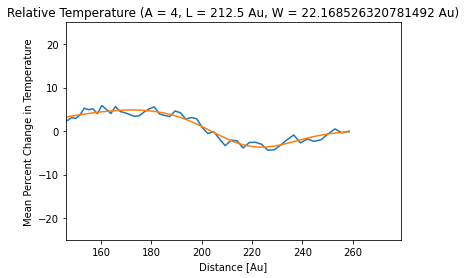

[  4.93490917 174.75101135  31.22560315  -5.29065556 219.87496825
  16.21013023]
Fit Equation: 4.93exp(-(R - 175.0)**2 / 2*31.2**2) + -5.29exp(-(R - 220.0)**2 / 2*16.2**2)
Maximum Value: 5.881636969121072
457
Minimum Value: -4.399479131307516
488


/tmp/ipykernel_171/1076665847.py:52: RuntimeWarning: divide by zero encountered in true_divide
  T_for_mean[k + 20] = 100*(temp_list[i][j][k] - NoPertTemp[k]) / NoPertTemp[k]
/tmp/ipykernel_171/1076665847.py:52: RuntimeWarning: invalid value encountered in true_divide
  T_for_mean[k + 20] = 100*(temp_list[i][j][k] - NoPertTemp[k]) / NoPertTemp[k]


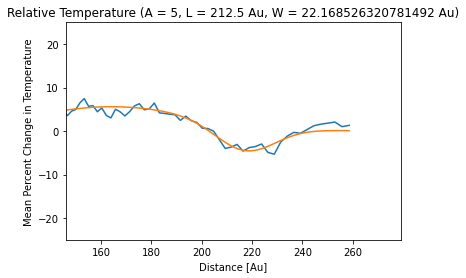

[  5.60157525 164.24596653  33.25278948  -6.08364993 217.21531682
  11.61312972]
Fit Equation: 5.6exp(-(R - 164.0)**2 / 2*33.3**2) + -6.08exp(-(R - 217.0)**2 / 2*11.6**2)
Maximum Value: 7.468766995644011
453
Minimum Value: -5.323090194351266
489


/tmp/ipykernel_171/1076665847.py:52: RuntimeWarning: divide by zero encountered in true_divide
  T_for_mean[k + 20] = 100*(temp_list[i][j][k] - NoPertTemp[k]) / NoPertTemp[k]


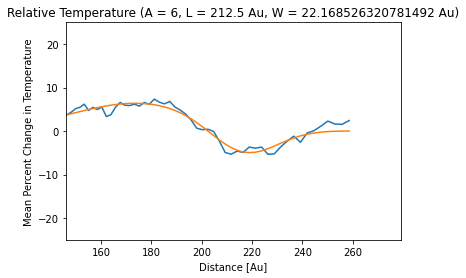

[  6.41871926 174.29351819  26.76600252  -6.66757674 216.52551
  12.9615495 ]
Fit Equation: 6.42exp(-(R - 174.0)**2 / 2*26.8**2) + -6.67exp(-(R - 217.0)**2 / 2*13.0**2)
Maximum Value: 7.354161219331526
468
Minimum Value: -5.334061393258017
488


/tmp/ipykernel_171/1076665847.py:52: RuntimeWarning: divide by zero encountered in true_divide
  T_for_mean[k + 20] = 100*(temp_list[i][j][k] - NoPertTemp[k]) / NoPertTemp[k]
/tmp/ipykernel_171/1076665847.py:52: RuntimeWarning: invalid value encountered in true_divide
  T_for_mean[k + 20] = 100*(temp_list[i][j][k] - NoPertTemp[k]) / NoPertTemp[k]


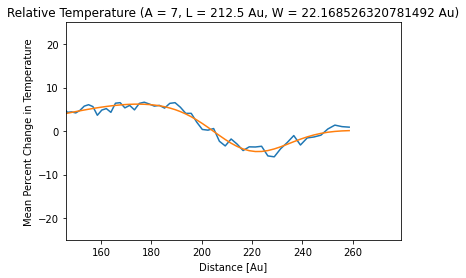

[  6.29304771 177.33122874  33.25278948  -7.39963358 219.248608
  14.77237212]
Fit Equation: 6.29exp(-(R - 177.0)**2 / 2*33.3**2) + -7.4exp(-(R - 219.0)**2 / 2*14.8**2)
Maximum Value: 6.636240740166149
466
Minimum Value: -5.919706864231554
489


/tmp/ipykernel_171/1076665847.py:52: RuntimeWarning: divide by zero encountered in true_divide
  T_for_mean[k + 20] = 100*(temp_list[i][j][k] - NoPertTemp[k]) / NoPertTemp[k]


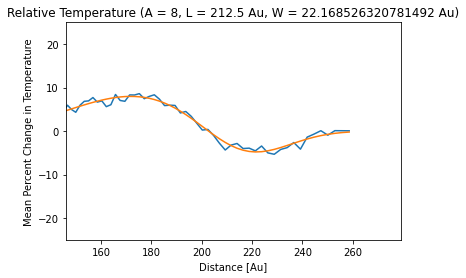

[  8.14862215 173.93131941  26.52778456  -6.6658158  217.09707611
  16.39146078]
Fit Equation: 8.15exp(-(R - 174.0)**2 / 2*26.5**2) + -6.67exp(-(R - 217.0)**2 / 2*16.4**2)
Maximum Value: 8.60889545107256
465
Minimum Value: -5.332652639048278
489


/tmp/ipykernel_171/1076665847.py:52: RuntimeWarning: divide by zero encountered in true_divide
  T_for_mean[k + 20] = 100*(temp_list[i][j][k] - NoPertTemp[k]) / NoPertTemp[k]


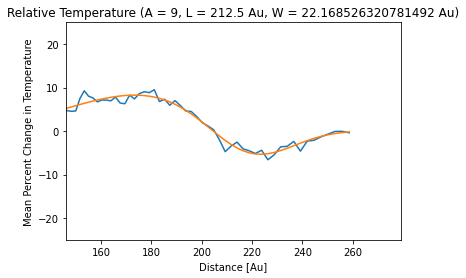

[  8.46221624 176.3340225   30.67548534  -8.24026059 219.00041937
  16.2524906 ]
Fit Equation: 8.46exp(-(R - 176.0)**2 / 2*30.7**2) + -8.24exp(-(R - 219.0)**2 / 2*16.3**2)
Maximum Value: 9.508528084743475
468
Minimum Value: -6.592208471516357
488


/tmp/ipykernel_171/1076665847.py:52: RuntimeWarning: divide by zero encountered in true_divide
  T_for_mean[k + 20] = 100*(temp_list[i][j][k] - NoPertTemp[k]) / NoPertTemp[k]
/tmp/ipykernel_171/1076665847.py:52: RuntimeWarning: invalid value encountered in true_divide
  T_for_mean[k + 20] = 100*(temp_list[i][j][k] - NoPertTemp[k]) / NoPertTemp[k]


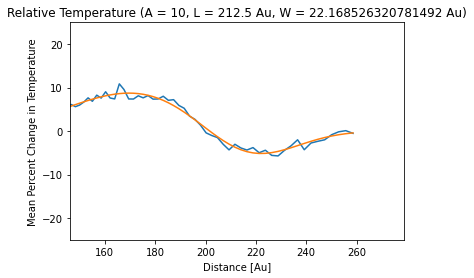

[  9.00573926 172.30510914  27.15290246  -7.14177304 216.72812028
  17.98274247]
Fit Equation: 9.01exp(-(R - 172.0)**2 / 2*27.2**2) + -7.14exp(-(R - 217.0)**2 / 2*18.0**2)
Maximum Value: 10.85840750605309
460
Minimum Value: -5.713418430466926
489


/tmp/ipykernel_171/1076665847.py:52: RuntimeWarning: divide by zero encountered in true_divide
  T_for_mean[k + 20] = 100*(temp_list[i][j][k] - NoPertTemp[k]) / NoPertTemp[k]


IndexError: index 500 is out of bounds for axis 0 with size 500

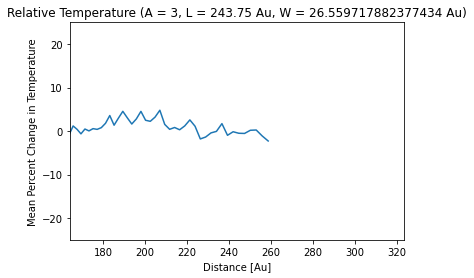

In [10]:
#Mean Relative Temperature Plots and Curve-Fitting
from scipy.optimize import curve_fit
amp_initial, amp_final, loc_initial, loc_final, a_step, l_step = 3, 11, 25*au, 275*au, 1, 31.25*au
amp_arr = np.array([])
loc_arr = np.array([])
T_max = np.empty((int((loc_final - loc_initial) / l_step), int((amp_final - amp_initial) / a_step)))
T_max_index = np.empty((int((loc_final - loc_initial) / l_step), int((amp_final - amp_initial) / a_step)))
for i in range(0, int((loc_final - loc_initial) / l_step)):
    for j in range(0, int((amp_final - amp_initial) / a_step)):
        x = data.grid.x/natconst.au
        l = i*l_step + loc_initial
        a = j*a_step + amp_initial
        
        #Append only unique amplitude and location values 
        if a not in amp_arr:
            amp_arr = np.append(amp_arr, a)
        else:
            pass
        if l not in loc_arr:
            loc_arr = np.append(loc_arr, l)
        else: 
            pass
        
        #The index of x which corresponds to the value in x closest to the location of the perturbation
        l_index = np.abs(x - (l / au)).argmin()
        width = hp[l_index]
        
        #Create a loop to find an equally spaced interval on either side of the perturbation
        for backward in range(1, l_index): 
            if abs(x[l_index] - x[l_index - backward]) <= 3*width / au: 
                pass
            else:
                B = backward
                break

        for forward in range(1, len(x) - l_index):
            if abs(x[l_index] - x[l_index + forward]) <= 3*width / au:
                pass
            else:
                F = forward
                break
        
        fig, ax = plt.subplots()
        ax.set_title('Relative Temperature (A = '+str(j*a_step + amp_initial)+', L = '+str(l/au)+' Au, W = '+str(hp[l_index] / au)+' Au)')
        ax.set_xlabel('Distance [Au]')
        ax.set_ylabel('Mean Percent Change in Temperature')
        ax.set_ylim(-25, 25)
        
        #Calculate the mean percent change in temperature over the first 20 values in the angular direction
        T_for_mean = [[] for k in range(0, 19)]
        for k in range(-20,-1):
            T_for_mean[k + 20] = 100*(temp_list[i][j][k] - NoPertTemp[k]) / NoPertTemp[k]
        
        T_mean = sum(T_for_mean) / len(T_for_mean)
        ax.set_xlim((l - 3*width) / au, (l + 3*width) / au)
        ax.plot(x, T_mean)
        
        #Find the maximum value in the desired range
        max_value = 0
        index = l_index - B
        max_index = l_index - B
        for n in T_mean[(l_index - B):(l_index + F)]:
            index = index + 1
            if n > max_value:
                max_value = n
                max_index = index
            else:
                pass
        T_max[i][j] = max_value
        T_max_index[i][j] = max_index
        
        #Find the minimum value in the desired range
        min_value = 0
        index = l_index - B
        min_index = l_index - B
        for n in T_mean[(l_index - B):(l_index + F)]:
            index = index + 1
            if n < min_value:
                min_value = n
                min_index = index
            else:
                pass
        
        #Define a function form for curve-fitting
        def fit_form(dist, a, b, c, d, e, f):
            return a*np.exp(-(dist - b)**2 / (2*c**2)) + d*np.exp(-(dist - e)**2 / (2*f**2))
            #return a*dist**5 + b*dist**4 + c*dist**3 + d*dist**2 + e*dist + f
        
        #Focus on the data in the desired range
        xdata = x[(l_index - B):(l_index + F)] #Save
        ydata = T_mean[(l_index - B):(l_index + F)] #Save
        p0 = [max_value, x[max_index], width / au, min_value, x[min_index], width / au]
        popt, pcov = curve_fit(fit_form, xdata, ydata, p0 = p0, bounds = [[max_value - max_value / 4, x[max_index] - width / 4, .5*width / au, min_value + min_value / 4, x[min_index] - width / 4, .5*width / au], [max_value + max_value / 4, x[max_index] + width / 4, 1.5*width / au, min_value - min_value / 4, x[min_index] + width / 4, 1.5*width / au]], maxfev = 100000)
        ax.plot(xdata, fit_form(xdata, *popt))
        plt.show()
        
        def round_func(num):
            return str(round(num, 2-int(np.floor(np.log10(abs(num))))))
        
        a, b, c, d, e, f = popt
        print(popt)                                                                                   
        print('Fit Equation: '+round_func(a)+'exp(-(R - '+round_func(b)+')**2 / 2*'+round_func(c)+'**2) + '+round_func(d)+'exp(-(R - '+round_func(e)+')**2 / 2*'+round_func(f)+'**2)')
        print("Maximum Value: " +str(max_value))
        print(max_index)
        print("Minimum Value: " +str(min_value))
        print(min_index)
        #print('Fit Equation: '+round_func(a)+'R**4 + '+round_func(b)+'R**3 + '+round_func(c)+'R**2 + '+round_func(d)+'R + '+round_func(e))
        
        
        


In [500]:
print(xdata)

[163.87955182 165.71227767 167.56549087 169.43945919 171.33438315
 173.25049654 175.18803349 177.14722779 179.12834682 181.13162473
 183.15729529 185.20562588 187.27685066 189.37123662 191.48908478
 193.63059603 195.79603701 197.9857091  200.1998793  202.43881537
 204.70275108 206.99202029 209.30692436 211.64769708 214.01463906
 216.40805129 218.8282344  221.27548938 223.75011684 226.25241778
 228.78269283 231.34127621 233.92846892 236.54457156 239.18995163
 241.8649437  244.56981518 247.30493314 250.07066581 252.86731381
 255.69524459 258.55479277]


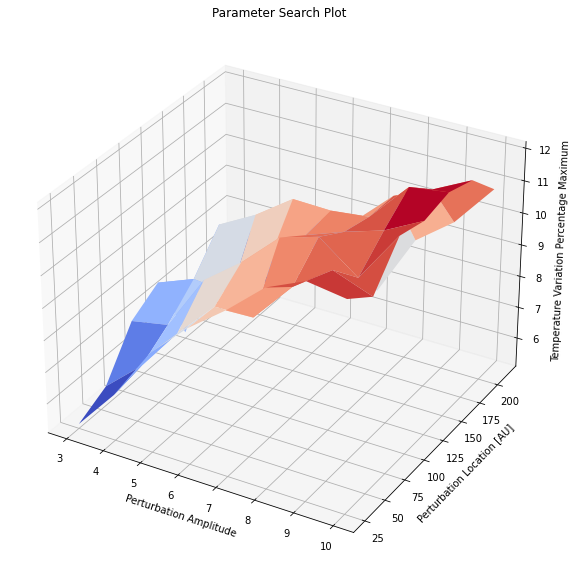

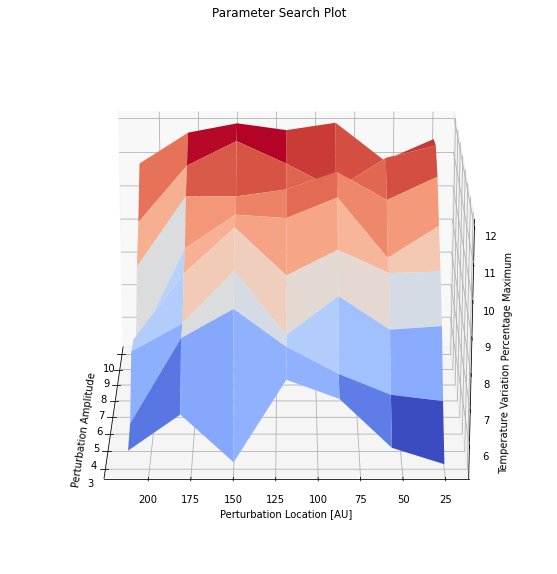

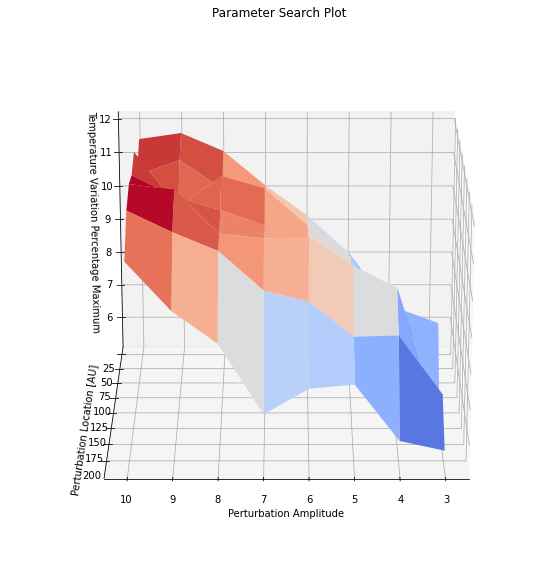

In [11]:
#Plot maximum temperature variation percentage as a function of radius and amplitude
fig = plt.figure(figsize = (10,10))
ax = plt.axes(projection='3d')
ax.set_title('Parameter Search Plot')
ax.set_xlabel('Perturbation Amplitude')
ax.set_ylabel('Perturbation Location [AU]')
ax.set_zlabel('Temperature Variation Percentage Maximum')

X, Y = np.meshgrid(amp_arr, loc_arr / au)
Z = T_max
ax.plot_surface(X[0:-1], Y[0:-1], Z[0:-1], rcount = 100, ccount = 100, edgecolor = 'none', cmap = cm.coolwarm)
plt.show()


fig = plt.figure(figsize = (10,10))
ax = plt.axes(projection='3d')
ax.set_title('Parameter Search Plot')
ax.set_xlabel('Perturbation Amplitude')
ax.set_ylabel('Perturbation Location [AU]')
ax.set_zlabel('Temperature Variation Percentage Maximum')

X, Y = np.meshgrid(amp_arr, loc_arr / au)
Z = T_max
ax.plot_surface(X[0:-1], Y[0:-1], Z[0:-1], rcount = 100, ccount = 100, edgecolor = 'none', cmap = cm.coolwarm)
ax.view_init(20,180)
plt.show()

fig = plt.figure(figsize = (10,10))
ax = plt.axes(projection='3d')
ax.set_title('Parameter Search Plot')
ax.set_xlabel('Perturbation Amplitude')
ax.set_ylabel('Perturbation Location [AU]')
ax.set_zlabel('Temperature Variation Percentage Maximum')
ax.plot_surface(X[0:-1], Y[0:-1], Z[0:-1], rcount = 100, ccount = 100, edgecolor = 'none', cmap = cm.coolwarm)
ax.view_init(20,90)
plt.show()

#2D scatter plots: input surface density ampltiude and output temperature variation amplitude 
#Characterize difference in temperature max between inner and outer disk

/tmp/ipykernel_171/2285134985.py:36: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()


IndexError: index 500 is out of bounds for axis 0 with size 500

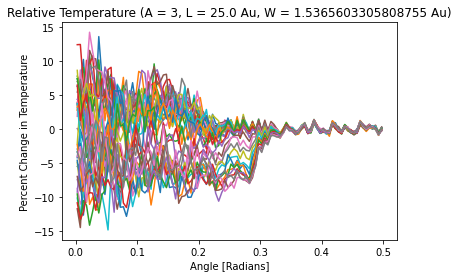

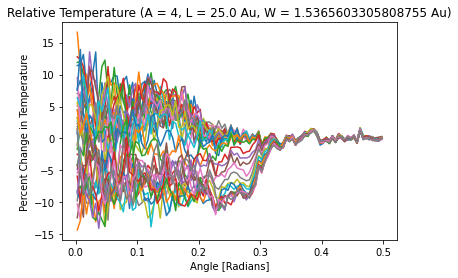

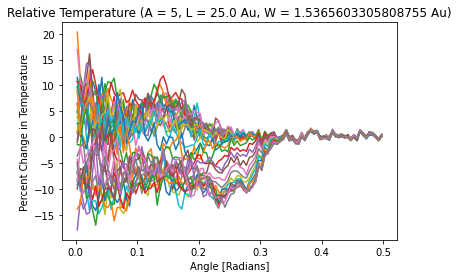

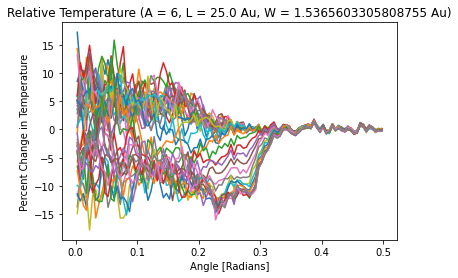

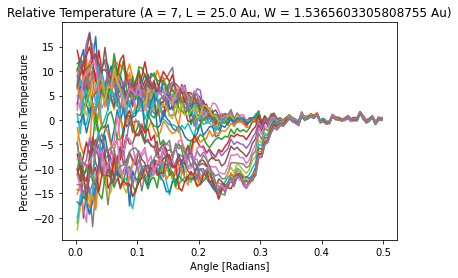

...

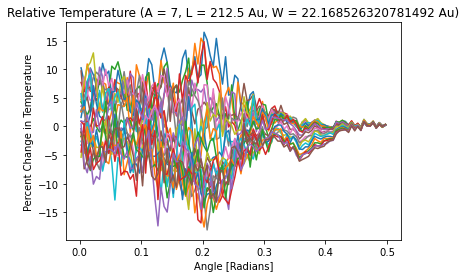

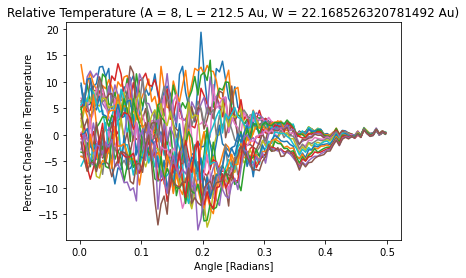

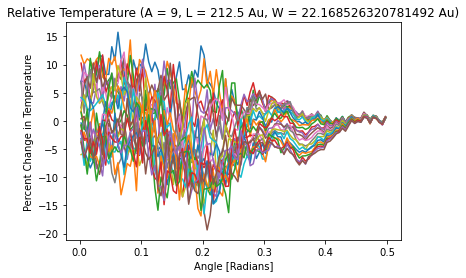

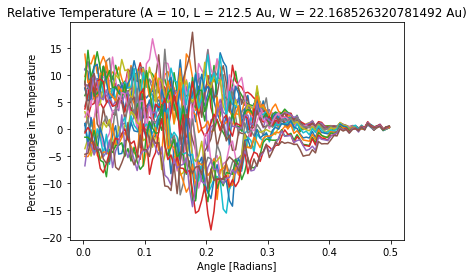

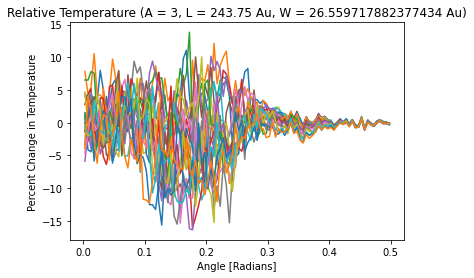

In [12]:
from scipy.optimize import curve_fit
amp_initial, amp_final, loc_initial, loc_final, a_step, l_step = 3, 11, 25*au, 275*au, 1, 31.25*au
T_max = np.empty((int((loc_final - loc_initial) / l_step), int((amp_final - amp_initial) / a_step)))
for i in range(0, int((loc_final - loc_initial) / l_step)):
    for j in range(0, int((amp_final - amp_initial) / a_step)):
        x = data.grid.x/natconst.au
        l = i*l_step + loc_initial
        a = j*a_step + amp_initial
        #Append only unique amplitude and location values 
        if a not in amp_arr:
            amp_arr = np.append(amp_arr, a)
        else:
            pass
        if l not in loc_arr:
            loc_arr = np.append(loc_arr, l)
        else: 
            pass
        #The index of x which corresponds to the value in x closest to the location of the perturbation
        l_index = np.abs(x - (l / au)).argmin()
        width = hp[l_index]
        #Create a loop to find an equally spaced interval on either side of the temperature variation maximum
        for backward in range(1, l_index): 
            if abs(x[int(T_max_index[i][j])] - x[int(T_max_index[i][j]) - backward]) <= 3: 
                pass
            else:
                B = backward
                break

        for forward in range(1, len(X) - l_index):
            if abs(x[int(T_max_index[i][j])] - x[int(T_max_index[i][j]) + forward]) <= 3:
                pass
            else:
                F = forward
                break
        
        fig, ax = plt.subplots()
        ax.set_title('Relative Temperature (A = '+str(j*a_step + amp_initial)+', L = '+str(l/au)+' Au, W = '+str(hp[l_index] / au)+' Au)')
        ax.set_xlabel('Angle [Radians]')
        ax.set_ylabel('Percent Change in Temperature')
        #ax.set_ylim(-25, 25)
        
        for k in range((int(T_max_index[i][j]) - B), (int(T_max_index[i][j]) + F)):
            ax.plot(np.pi/2.-data.grid.y, 100*(np.transpose(np.transpose(temp_list[i][j])[k]) - np.transpose(np.transpose(NoPertTemp)[k])) / np.transpose(np.transpose(NoPertTemp)[k]))
        
        #T_mean = sum(T_for_mean) / len(T_for_mean)
        
        #ax.set_xlim((l - 3*width) / au, (l + 3*width) / au)
        #ax.plot(x, T_mean)

In [ ]:
#
# Make sure to have done the following beforhand:
#
#  First compile RADMC-3D
#  Then run:
#   python problem_setup.py
#   radmc3d mctherm
#

dpc = 140.     # Distance in parsec (for conversion to Jy/pixel in 1.3 mm map)

#
# Make and plot image of full disk at 1.3 mm: thermal dust emission
#
makeImage(npix=200,incl=60.,phi=30.,wav=1.0e3,sizeau=200)   # This calls radmc3d 
im_mmPrePert1 = readImage()
plt.figure()
plotImage(im_mmPrePert1,au=True,log=True,maxlog=3,bunit='jy/pixel',dpc=dpc,cmap='magma')
plt.show()

    
#
# Make and plot image of full disk at 1 microns: scattered light
#
makeImage(npix=200,incl=60.,phi=30.,wav=10,sizeau=200)   # This calls radmc3d 
im_1PrePert2 = readImage()
plt.figure()
plotImage(im_1PrePert2,au=True,log=True,vmax=-10,vmin=-15,bunit='inu',cmap='hot')
plt.show()